## **Group Members**

Group 35: Our Group is composed by:

  - Filipe Ferreira -20240741
  - Helena Duarte- 20240530
  - Iris Moreira-20240659
  - João Freire-20240528
  - Osmainy Raimundo-e20191506



## **METADATA**

- *Accident Date* - Injury date of the claim. 
- *Age at Injury* - Age of injured worker when the injury occurred.
- *Alternative Dispute Resolution* - Adjudication processes external to the Board.
- *Assembly Date* - The date the claim was first assembled.
- *Attorney/Representative* - Is the claim being represented by an Attorney?
- *Average Weekly Wage*  - The wage used to calculate workers’ compensation, disability, or an Paid Leave wage replacement benefits.
- *Birth Year* - The reported year of birth of the injured worker.
- *C-2 Date* - Date of receipt of the Employer's Report of Work-Related Injury/Illness or equivalent (formerly Form C-2).
- *C-3 Date* -  Date Form C-3 (Employee Claim Form) was received.
- *Carrier Name* - Name of primary insurance provider responsible for providing workers’ compensation coverage to the injured worker’s employer.
- *Carrier Type* - Type of primary insurance provider responsible for providing workers’ compensation coverage.
- *Claim Identifier* - Unique identifier for each claim, assigned by WCB
- *County of Injury* - Name of the New York County where the injury occurred.
- *COVID-19 Indicator* - Indication that the claim may be associated with COVID-19.
- *District Name* - Name of the WCB district office that oversees claims for that region or area of the state.
- *First Hearing Date* - Date the first hearing was held on a claim at a WCB hearing location. A blank date means the claim has not yet had a hearing held.
- *Gender* - The reported gender of the injured worker.
- *IME-4 Count* - Number of IME-4 forms received per claim. The IME-4 form is the “Independent Examiner's Report of Independent Medical Examination” form.
- *Industry Code* - NAICS code and descriptions are available at: https://www.naics.com/search-naics-codes-by-industry/.
- *Industry Code Description* - 2-digit NAICS industry code description used to classify businesses according to their economic activity.
- *Medical Fee Region* - Approximate region where the injured worker would receive medical service.
  
- *OIICS Nature of Injury Description* - The OIICS nature of injury codes & descriptions are available at bls.gov/iif/oiics_manual_2007.pemployees_train .
- *WCIO Cause of Injury Code* - The WCIO cause of injury codes & descriptions are at https://www.wcio.org/Active%20PNC/WCIO_Cause_Table.pemployees_train .
- *WCIO Cause of Injury Description* - See description of field above.
- *WCIO Nature of Injury Code* -The WCIO nature of injury are available at https://wwwn.cdc.gov/wisards/oiics/Trees/MultiTree.aspx?TreeType=BodyPart
- *WCIO Nature of Injury Description* - See description of field above.
- *WCIO Part Of Body Code* - The WCIO part of body codes & descriptions are available at https://wwwn.cdc.gov/wisards/oiics/Trees/MultiTree.aspx?TreeType=BodyPart
- *WCIO Part Of Body Description* - See description of field above.
- *Zip Code* - The reported ZIP code of the injured worker’s home address.
- <strong> *Agreement Reached* - Binary variable: Yes if there is an agreement without the involvement of the WCB -> unknown at the start of a claim.
- *WCB Decision* - Multiclass variable: Decision of the WCB relative to the claim: “Accident” means that claim refers to workplace accident </strong> , “Occupational Disease” means illness from the workplace. -> requires WCB deliberation so it is unknown at start of claim.
-  *Claim Injury Type* - Main target variable: Deliberation of the WCB relative to benefits awarded to the claim. Numbering indicates severity. 




## **Table of Contents**

<div class="alert alert-block alert-info">

- [1. Importing the dataset and the libraries](#1)<br>
- [2. Feature Selection](#2)<br>
    - [2.1 Filter Methods](#2.1)<br>
    - [2.2 Wrapper Methods](#2.2)<br>
    - [2.3 Embedded Methods](#2.3)<br>
    - [2.4 Class specific analysis - Open-ended section](#2.4)<br>
    - [2.5 Final Insights](#2.5)<br>

    
</div>

<a class="anchor" id="1">

# Importing the necessary libraries and datasets
    
</a>

Importing the necessary libraries

In [1]:
#Basic libraries libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from itertools import combinations
from math import ceil

#Exploratory Data Analysis
import scipy.stats as stats
from scipy.stats import chi2_contingency
pd.set_option('display.max_columns', None)


#Feature Selection
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import SelectFromModel
from sklearn.feature_selection import chi2
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import RFE
from sklearn.feature_selection import mutual_info_classif
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier


#Extras
import warnings
warnings.filterwarnings('ignore')



**Importing the Datasets**

Training Data

In [2]:
X_train_num = pd.read_csv("../Data/copy_X_train_num.csv", index_col="Claim Identifier")
X_train_cat = pd.read_csv("../Data/copy_X_train_cat.csv", index_col="Claim Identifier")
df_target_train = pd.read_csv("../Data/copy_target_train.csv", index_col="Claim Identifier")
X_train_all = pd.concat([X_train_num, X_train_cat], axis=1)

In [3]:
print(len(X_train_num))
print(len(X_train_cat))
print(len(df_target_train))
print(len(X_train_all))

401222
401222
401222
401222


Validation Data

In [4]:
X_val_num = pd.read_csv("../Data/copy_X_val_num.csv", index_col="Claim Identifier")
X_val_cat = pd.read_csv("../Data/copy_X_val_cat.csv", index_col="Claim Identifier")
df_target_val = pd.read_csv("../Data/copy_target_val.csv", index_col="Claim Identifier")
X_val_all = pd.concat([X_val_num, X_val_cat], axis=1)

In [5]:
print(len(X_val_num))
print(len(X_val_cat))
print(len(df_target_val))
print(len(X_val_all))

172208
172208
172208
172208


Test Data

In [6]:
employees_test_num = pd.read_csv("../Data/copy_employees_test_num.csv", index_col="Claim Identifier")
employees_test_cat = pd.read_csv("../Data/copy_employees_test_cat.csv", index_col="Claim Identifier")
employees_test_all = pd.concat([employees_test_num,employees_test_cat], axis=1)

In [7]:
print(len(employees_test_num))
print(len(employees_test_cat))
print(len(employees_test_all))

387975
387975
387975


In [8]:
target_train = df_target_train['Claim Injury Type'].to_numpy()
target_val = df_target_val['Claim Injury Type'].to_numpy()

In [9]:
print(len(target_train))
print(len(target_val))

401222
172208



<a class="anchor" id="2">

# Feature Selection
    
</a>

<a class="anchor" id="2.1">

## Filter Methods
    
</a>


### Univariate Variables

In [10]:
X_train_num.var()

Age at Injury                             0.024672
Average Weekly Wage                       0.022368
Birth Year                                0.013612
Number of Dependents                      0.111173
Diff_days_assembly_accident               0.000697
Average Weekly Wage log                   0.156858
Carrier Name_Frqc                         0.142203
County of Injury_Frqc                     0.120710
District Name_Frqc                        0.163658
Industry Code Description_Frqc            0.103845
WCIO Part Of Body Description_Frqc        0.096446
WCIO Nature of Injury Description_Frqc    0.136776
WCIO Cause of Injury Description_Frqc     0.077929
AWW_Category_Frqc                         0.179375
age_injury_group_Frqc                     0.049953
Zip_Main_Characteristic_Frqc              0.064448
Accident_Day_Of_Week_Frqc                 0.105748
Assembly_Day_Of_Week_Frqc                 0.007830
Accident_Year                             0.000882
Accident_Month                 

### Correlation Indices

#### Spearman Correlation (Numerical)

<Axes: >

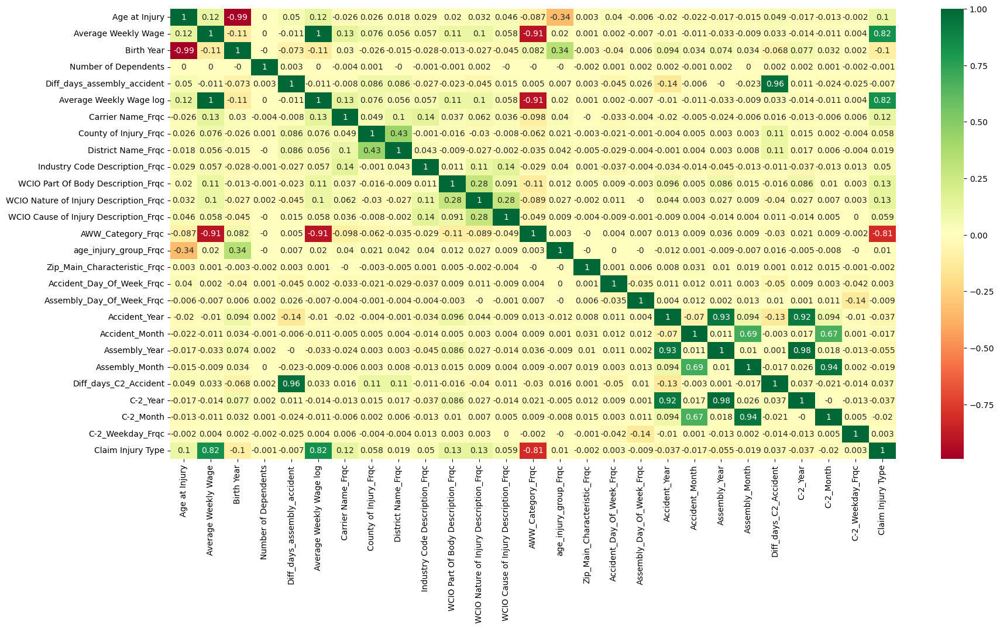

In [11]:
#plot heat map
plt.figure(figsize=(20,10))
X_train_and_target= pd.concat([X_train_num, df_target_train], axis=1)
sns.heatmap(X_train_and_target.corr(method='spearman').round(3), annot=True, cmap="RdYlGn")

In [139]:
spearman_corr = X_train_num.corrwith(df_target_train["Claim Injury Type"], method='spearman').abs()

#Select features with a Spearman correlation above 0.1
spearman_selected = spearman_corr[spearman_corr > 0.1].index.tolist()

In [140]:
spearman_selected

['Age at Injury',
 'Average Weekly Wage',
 'Birth Year',
 'Average Weekly Wage log',
 'Carrier Name_Frqc',
 'WCIO Part Of Body Description_Frqc',
 'WCIO Nature of Injury Description_Frqc',
 'AWW_Category_Frqc']

**`Conclusion`**: <br>

*Very High Correlations:*
* Average Weekly Wage & Average Weekly Wage log & AWW_Category_Frq
* Birth Year & Age At Injury

*Highest Feature Relevancy with the target variable:*
* Average Weekly Wage & Average Weekly Wage log (choose one of these to keep)

**For now, We can discard AWW_Category_Frq variable.**

*Lowest Feature Relevancy with the target variable (considering a threshould of 0.05):*
* Number of Dependents
* Diff_days_assembly_accident
* District Name_Frqc
* age_injury_group_Frqc
* Classification_Zip_Code_Frqc
* All the Accident/Assembly/C-2 year, Month and Weekday

### Association Indices


#### Chi-Squared (Categorical)

In [165]:
def TestIndependence(X, y, var, alpha=0.05):        
    dfObserved = pd.crosstab(y, X) 
    chi2, p, dof, expected = stats.chi2_contingency(dfObserved.values)
    if p < alpha:
        print(f"{var} is \033[1;35mIMPORTANT\033[0m for Prediction")
        return True
    else:
        print(f"{var} is \033[1;36mNOT\033[0m an important predictor. (Discard {var} from model)")
        return False


In [166]:

chi2_results = []
for var in X_train_cat.columns:
    is_important = TestIndependence(X_train_cat[var], target_train, var)
    chi2_results.append(is_important)


Attorney/Representative is IMPORTANT for Prediction
has_c3_date is IMPORTANT for Prediction
COVID-19 Indicator is IMPORTANT for Prediction
has_first_hearing_date is IMPORTANT for Prediction
has_ime is IMPORTANT for Prediction
Alternative Dispute Resolution_N is IMPORTANT for Prediction
Alternative Dispute Resolution_UNKNOWN is NOT an important predictor. (Discard Alternative Dispute Resolution_UNKNOWN from model)
Alternative Dispute Resolution_Y is IMPORTANT for Prediction
Carrier Type_1A. PRIVATE is IMPORTANT for Prediction
Carrier Type_2A. SIF is IMPORTANT for Prediction
Carrier Type_3A. SELF PUBLIC is IMPORTANT for Prediction
Carrier Type_4A. SELF PRIVATE is IMPORTANT for Prediction
Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A) is IMPORTANT for Prediction
Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS is IMPORTANT for Prediction
Carrier Type_5D. SPECIAL FUND - UNKNOWN is IMPORTANT for Prediction
Carrier Type_UNKNOWN is IMPORTANT for Prediction
Gender_F is IMPORTA

#### Mutual Information (Categorical)

In [15]:
mi_scores = mutual_info_classif(X_train_cat, target_train)

In [ ]:
feature_importance = pd.DataFrame({
    'Feature': X_train_cat.columns,
    'MI_Score': mi_scores
})
feature_importance = feature_importance.sort_values(by='MI_Score', ascending=False)
feature_importance

,Feature,MI_Score
51,AWW_Category_Zero,0.515203
4,has_ime,0.210572
0,Attorney/Representative,0.209774
3,has_first_hearing_date,0.163330
49,AWW_Category_Medium,0.148554
1,has_c3_date,0.122093
48,AWW_Category_Low,0.113180
34,WCIO Nature of Injury Description Category_Spe...,0.047156
46,WCIO Cause of Injury Description Category_Unknown,0.039389
47,AWW_Category_High,0.039124


Features with an MI score lower than 0.001:
- 'WCIO Cause of Injury Description Category_Striking Against or Stepping On'
- 'Alternative Dispute Resolution_UNKNOWN'
- 'Medical Fee Region_III'
- 'WCIO Cause of Injury Description Category_Caught In, Under or Between'
- 'age_injury_group_65+'
- 'Gender_UNKNOWN'
- 'WCIO Nature of Injury Description Category_Multiple Injuries'
- 'WCIO Cause of Injury Description Category_Rubbed or Abraded By'
- 'Carrier Type_5D. SPECIAL FUND - UNKNOWN'
- 'Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A)'
- 'age_injury_group_< 18'

**Class Specific mutual information classification**

In [17]:


for target_class in df_target_train['Claim Injury Type'].unique():

    binary_target = (df_target_train['Claim Injury Type'] == target_class).astype(int)
    
    mi_scores = mutual_info_classif(X_train_cat, binary_target)
    
    mi_df = pd.DataFrame({
        'Feature': X_train_cat.columns,
        'MI Score': mi_scores
    })
    
    mi_df = mi_df.sort_values(by='MI Score', ascending=False)
    
    print(f"MI scores for class \033[1;35m{target_class}\033[1;0m:")
    print(mi_df) 
    print("\n")


MI scores for class 1:
                                              Feature  MI Score
51                                  AWW_Category_Zero  0.420163
0                             Attorney/Representative  0.176714
4                                             has_ime  0.167168
3                              has_first_hearing_date  0.150930
49                                AWW_Category_Medium  0.126668
1                                         has_c3_date  0.112654
48                                   AWW_Category_Low  0.096588
17                                           Gender_M  0.042401
34  WCIO Nature of Injury Description Category_Spe...  0.039175
5                    Alternative Dispute Resolution_N  0.038538
8                            Carrier Type_1A. PRIVATE  0.036608
47                                  AWW_Category_High  0.034224
50                              AWW_Category_Very Low  0.031983
23                              Medical Fee Region_IV  0.030518
16               

We observed that although most of the features have common abundant features, some features score higher for some categories.

In [18]:
X_train_cat['WCIO Nature of Injury Description Category_Multiple Injuries' ]

Claim Identifier
5479022    0.0
6023025    0.0
5851908    0.0
5913931    0.0
5845976    1.0
          ... 
5655355    0.0
5940234    0.0
6073417    0.0
5822576    0.0
5566085    0.0
Name: WCIO Nature of Injury Description Category_Multiple Injuries, Length: 401222, dtype: float64

Highest and second highest MI score for each class:

- class 0 - 'WCIO Nature of Injury Description Category_Specific Injury'; 'AWW_Category_Zero'
- class 1 - 'AWW_Category_Zero'; 'Attorney/Representative'
- class 2 - 'AWW_Category_Zero'; 'Gender_M'
- class 3 - 'AWW_Category_Zero'; 'AWW_Category_Low'
- class 4 - 'AWW_Category_Zero'; 'Attorney/Representative'
- class 5 - 'AWW_Category_Zero'; 'Gender_M'
- class 6 - 'AWW_Category_Zero'; 'Gender_M'
- class 7 - 'AWW_Category_Zero'; 'WCIO Nature of Injury Description Category_Specific Injury'

Lowest MI score for each class (MI score = 0.000000):

- class 0 - 'age_injury_group_< 18'; 'WCIO Cause of Injury Description Category_Rubbed or Abraded By; 'Carrier Type_5D. SPECIAL FUND - UNKNOWN'; 'Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS'; 'WCIO Part of Body Description Category_Neck'; 'Alternative Dispute Resolution_UNKNOWN'; 'Alternative Dispute Resolution_Y'
- class 1 - 'Alternative Dispute Resolution_UNKNOWN'; 'Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS'; 'Carrier Type_5D. SPECIAL FUND - UNKNOWN'; 'WCIO Part of Body Description Category_Unknown';
- class 2 - 'Alternative Dispute Resolution_UNKNOWN'; 'Alternative Dispute Resolution_Y'; 'WCIO Nature of Injury Description Category_Multiple Injuries' ; 'WCIO Cause of Injury Description Category_Burn or Scald - Heat or Cold Exposures - Contact With'
- class 3 - 'age_injury_group_< 18'; 'WCIO Cause of Injury Description Category_Caught In, Under or Between'; 'Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A)'; 'Carrier Type_5D. SPECIAL FUND - UNKNOWN'
- class 4 - 'age_injury_group_< 18'; 'Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS'; 'Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A)'; 'Gender_X'; 'Carrier Type_UNKNOWN'
- class 5 - 'age_injury_group_< 18'; 'Alternative Dispute Resolution_UNKNOWN'
- class 6 - 'Carrier Type_5D. SPECIAL FUND - UNKNOWN'; 'Gender_X'
- class 7 - 'Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS'; 'Gender_X'; 'WCIO Cause of Injury Description Category_Rubbed or Abraded By'; 'Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A)'

Should drop?
- 'WCIO Cause of Injury Description Category_Striking Against or Stepping On' 
- 'Alternative Dispute Resolution_UNKNOWN'
- 'Medical Fee Region_III'
- 'WCIO Cause of Injury Description Category_Caught In, Under or Between'
- 'age_injury_group_65+'
- 'Gender_UNKNOWN'
- 'WCIO Nature of Injury Description Category_Multiple Injuries'
- 'WCIO Cause of Injury Description Category_Rubbed or Abraded By'
- 'Carrier Type_5D. SPECIAL FUND - UNKNOWN'
- 'Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A)'
- 'Carrier Type_5D. SPECIAL FUND - UNKNOWN'
- 'age_injury_group_< 18'

#### Cramers' V (Categorical)

In [19]:
def cramers_v(x, y):
    confusion_matrix = pd.crosstab(x, y)
    chi2 = stats.chi2_contingency(confusion_matrix)[0]
    n = confusion_matrix.sum().sum()
    return np.sqrt(chi2 / (n * (min(confusion_matrix.shape) - 1)))


In [150]:
df_cramers = pd.concat([X_train_cat, df_target_train], axis=1)
results_cramer = pd.DataFrame(index=df_cramers.columns, columns=df_cramers.columns)

for var1 in df_cramers.columns:
    for var2 in df_cramers.columns:
        if var1 != var2:
            results_cramer.loc[var1, var2] = cramers_v(df_cramers[var1], df_cramers[var2])
        else:
            results_cramer.loc[var1, var2] = 1  #perfect association with itself


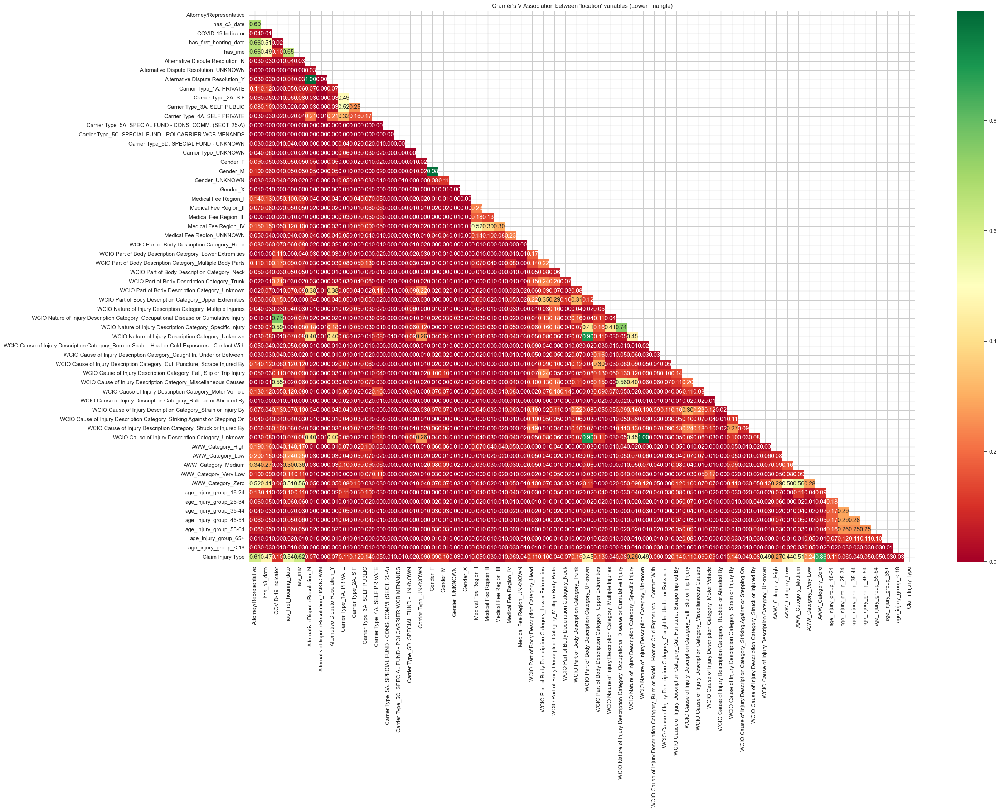

In [151]:
#Heatmap of Cramér's V
results_cramer = results_cramer.astype(float)
mask = np.triu(np.ones_like(results_cramer, dtype=bool))
plt.figure(figsize=(30, 20))
sns.heatmap(results_cramer, annot=True, cmap="RdYlGn", cbar=True, mask=mask, fmt='.2f', linewidths=0, linecolor='white')
plt.title("Cramér's V Association between 'location' variables (Lower Triangle)")

plt.show()

`Feature Relevancy`  (Threshould used: 0.15)

In [153]:
results_cramer[results_cramer.iloc[:, -1] > 0.15]["Claim Injury Type"].sort_values(ascending=False)

Claim Injury Type                                             1.000000
AWW_Category_Zero                                             0.864949
has_ime                                                       0.622540
Attorney/Representative                                       0.612566
has_first_hearing_date                                        0.540942
AWW_Category_Medium                                           0.510765
WCIO Nature of Injury Description Category_Unknown            0.493561
WCIO Cause of Injury Description Category_Unknown             0.493496
has_c3_date                                                   0.472179
WCIO Part of Body Description Category_Unknown                0.454744
AWW_Category_Low                                              0.441319
AWW_Category_High                                             0.267268
WCIO Nature of Injury Description Category_Specific Injury    0.261297
AWW_Category_Very Low                                         0.242665
Name: 

`Feature Redundancy` (Threshould used: 0.6)
- 'Attorney/Representative' & 'has_ime' & 'has_first_hearing_date' & 'has_c3_date' (***Maybe drop 'has_c3_date'***)
- 'WCIO Nature of Injury Description Category_Occupational Disease or Cumulative Injury' & 'Covid-19_indicator' & 'WCIO Nature of Injury Description Category_Specific Injury' (***Maybe drop the WCIO related to Occupational Disease and 'Covid-19_indicator'***)
- 'Alternative Dispute Resolution_Y' & 'Alternative Dispute Resolution_N' (***Maybe drop both***)
- 'Gender_M' & 'Gender_F' -> (***Maybe drop 'Gender_F'***)
- 'WCIO Part of Body Description Category_Unknown' & 'WCIO Cause of Injury Description Category_Unknown' & 'WCIO Nature of Injury Description Category_Unknown -> (***Maybe drop 'WCIO Part of Body Description Category_Unknown'***)

In [ ]:
# Select features based on Cramer's V with the target variable (threshold > 0.15)
cramers_v_selected = results_cramer['Claim Injury Type'][results_cramer['Claim Injury Type'] > 0.15].index.tolist()

### SelectKBest

Using mutual_info_classif as score fucntion.

In [118]:
X_new_num = SelectKBest(score_func=mutual_info_classif, k='all').fit(X_train_num, target_train)
kbest_features = pd.DataFrame(X_new_num.scores_, X_new_num.feature_names_in_).rename(columns={0: "Score"})

In [119]:
kbest_features.sort_values("Score", ascending=False, inplace=True)

In [120]:
kbest_features

,Score
AWW_Category_Frqc,0.515627
Average Weekly Wage log,0.480273
Average Weekly Wage,0.479491
WCIO Nature of Injury Description_Frqc,0.110773
WCIO Part Of Body Description_Frqc,0.100317
WCIO Cause of Injury Description_Frqc,0.094679
Carrier Name_Frqc,0.070116
Industry Code Description_Frqc,0.054333
Diff_days_C2_Accident,0.028297
Accident_Year,0.026337


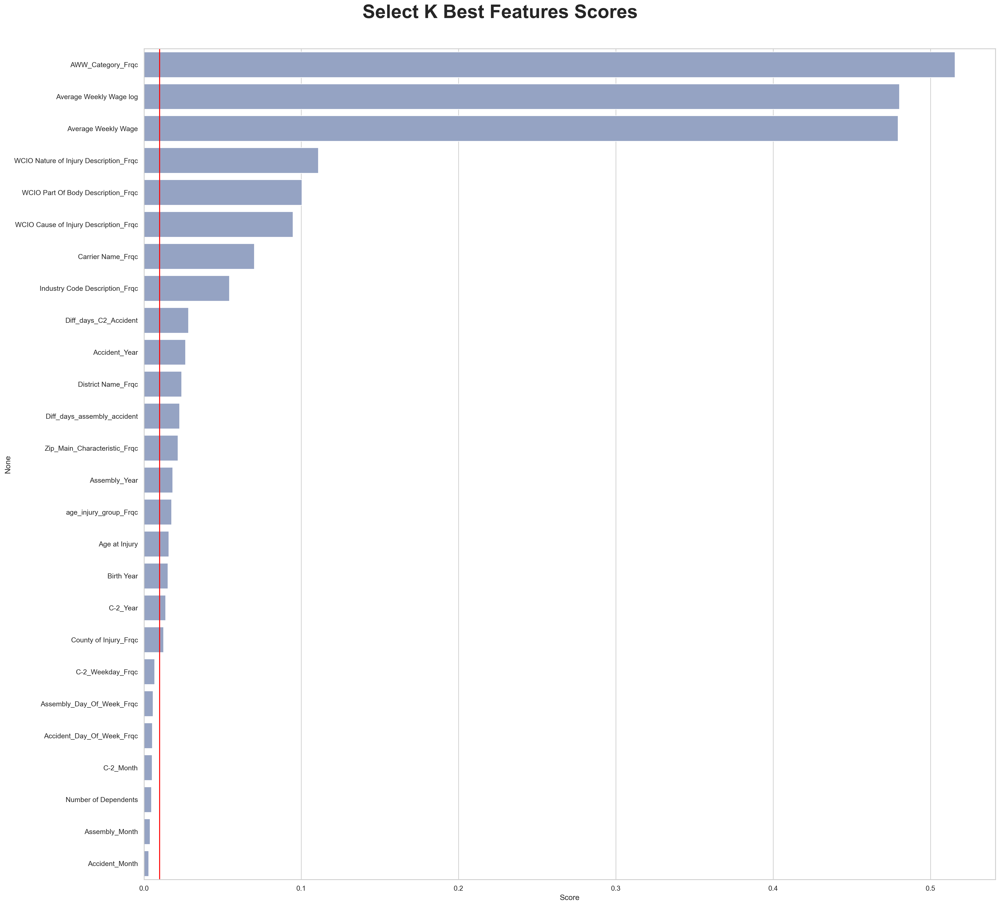

In [121]:
sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=0.01, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

In [122]:
kbest_features_bool=[]
for elem in kbest_features["Score"]:
    if elem > 0.01:  
        kbest_features_bool.append(True)
    else:
        kbest_features_bool.append(False)

In [123]:
k_features_num = pd.Series(kbest_features_bool, index = kbest_features.index).reindex(X_train_num.columns)


In [125]:
k_features_num

Age at Injury                              True
Average Weekly Wage                        True
Birth Year                                 True
Number of Dependents                      False
Diff_days_assembly_accident                True
Average Weekly Wage log                    True
Carrier Name_Frqc                          True
County of Injury_Frqc                      True
District Name_Frqc                         True
Industry Code Description_Frqc             True
WCIO Part Of Body Description_Frqc         True
WCIO Nature of Injury Description_Frqc     True
WCIO Cause of Injury Description_Frqc      True
AWW_Category_Frqc                          True
age_injury_group_Frqc                      True
Zip_Main_Characteristic_Frqc               True
Accident_Day_Of_Week_Frqc                 False
Assembly_Day_Of_Week_Frqc                 False
Accident_Year                              True
Accident_Month                            False
Assembly_Year                           

**Select K-Best: Categorical Variables**

Using Chi2 as the score function

In [126]:
X_new_cat= SelectKBest(score_func=chi2, k='all').fit(X_train_cat, target_train)
kbest_features_cat = pd.DataFrame(X_new_cat.scores_, X_new_cat.feature_names_in_).rename(columns={0: "Score"})

In [127]:
kbest_features_cat.sort_values("Score", ascending=False, inplace=True)

In [128]:
kbest_features_cat

,Score
has_ime,119521.683325
AWW_Category_Zero,109718.116405
Attorney/Representative,102936.206596
WCIO Nature of Injury Description Category_Unknown,95071.319950
WCIO Cause of Injury Description Category_Unknown,95049.287776
AWW_Category_Medium,88710.202388
has_first_hearing_date,86588.443822
WCIO Part of Body Description Category_Unknown,80505.441833
AWW_Category_Low,68351.647205
has_c3_date,60360.097985


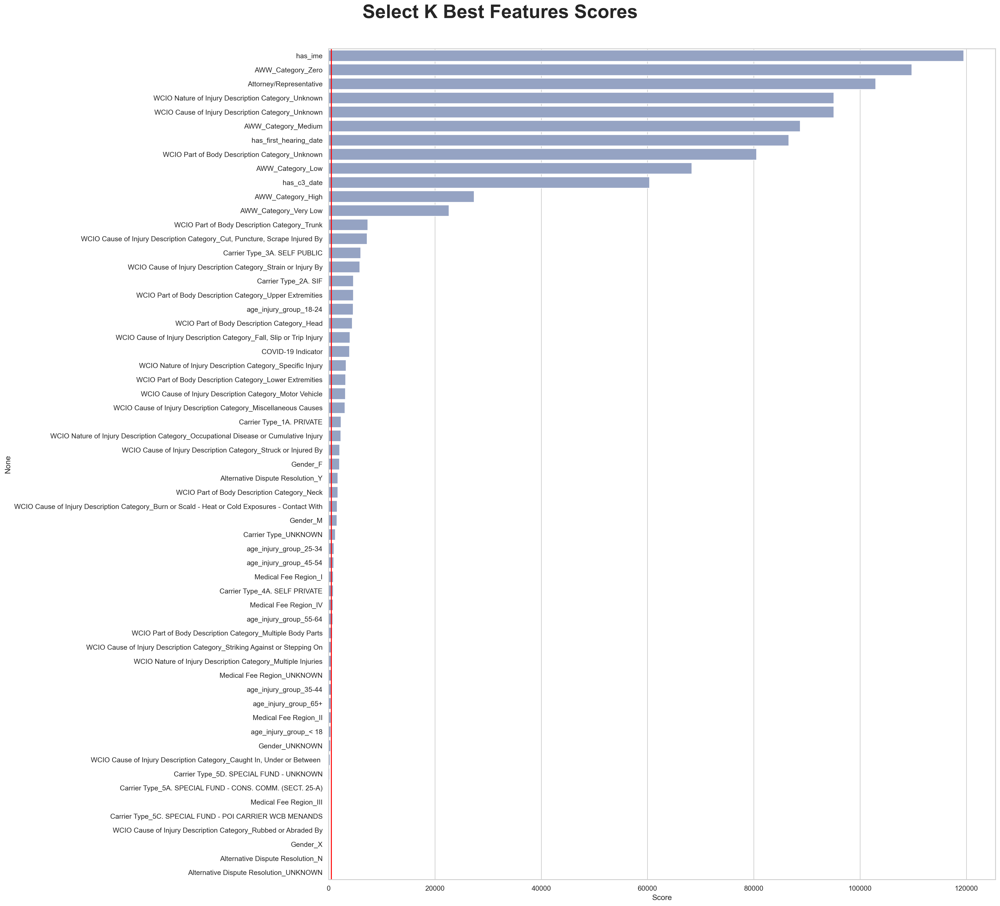

In [129]:
sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features_cat, y=kbest_features_cat.index, x=kbest_features_cat["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=500, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
#plt.savefig('Figures/SelectKBest_BarChart.png', dpi=600, bbox_inches='tight')
plt.show()

In [130]:
kbest_features_bool_cat=[]
for elem in kbest_features_cat["Score"]:
    if elem > 500:  
        kbest_features_bool_cat.append(True)
    else:
        kbest_features_bool_cat.append(False)

In [131]:
k_features_cat = pd.Series(kbest_features_bool_cat, index = kbest_features_cat.index).reindex(X_train_cat.columns)

In [132]:
k_features_cat

Attorney/Representative                                                                             True
has_c3_date                                                                                         True
COVID-19 Indicator                                                                                  True
has_first_hearing_date                                                                              True
has_ime                                                                                             True
Alternative Dispute Resolution_N                                                                   False
Alternative Dispute Resolution_UNKNOWN                                                             False
Alternative Dispute Resolution_Y                                                                    True
Carrier Type_1A. PRIVATE                                                                            True
Carrier Type_2A. SIF                                   

<a class="anchor" id="2.2">

## Wrapper Methods
    
</a>


### RFE - Using Logistic Regression as the base estimator

In [37]:
#Setting Logistic regression as the base estimator
model = LogisticRegression(multi_class='ovr', solver='lbfgs')


In [38]:
rfe = RFE(estimator = model, n_features_to_select = 11)
X_rfe = rfe.fit_transform(X = X_train_num, y = target_train)

In [39]:
rfe.support_

array([ True,  True,  True, False,  True,  True, False, False, False,
       False,  True,  True, False,  True, False, False, False, False,
        True, False, False, False,  True,  True, False, False])

In [40]:
selected_features = pd.Series(rfe.support_, index = X_train_num.columns)
selected_features

Age at Injury                              True
Average Weekly Wage                        True
Birth Year                                 True
Number of Dependents                      False
Diff_days_assembly_accident                True
Average Weekly Wage log                    True
Carrier Name_Frqc                         False
County of Injury_Frqc                     False
District Name_Frqc                        False
Industry Code Description_Frqc            False
WCIO Part Of Body Description_Frqc         True
WCIO Nature of Injury Description_Frqc     True
WCIO Cause of Injury Description_Frqc     False
AWW_Category_Frqc                          True
age_injury_group_Frqc                     False
Zip_Main_Characteristic_Frqc              False
Accident_Day_Of_Week_Frqc                 False
Assembly_Day_Of_Week_Frqc                 False
Accident_Year                              True
Accident_Month                            False
Assembly_Year                           

<a class="anchor" id="2.3">

## Embedded Methods
    
</a>


### Random Forest

**Random Forest- Numerical Variables**

In [41]:
embeded_rf_selector = SelectFromModel(RandomForestClassifier(n_estimators=110))
embeded_rf_selector.fit(X_train_num,target_train)

embeded_rf_support = embeded_rf_selector.get_support()
embeded_rf_feature = X_train_num.loc[:,embeded_rf_support].columns.tolist()
print(str(len(embeded_rf_feature)), 'selected features:')
for feature in embeded_rf_feature:
    print(feature)


7 selected features:
Average Weekly Wage
Diff_days_assembly_accident
Average Weekly Wage log
Carrier Name_Frqc
WCIO Part Of Body Description_Frqc
AWW_Category_Frqc
Diff_days_C2_Accident


**Random Forest- Categorical Variables**

Threshould used: 0.0017 

In [42]:
rf = RandomForestClassifier()
rf.fit(X_train_cat, df_target_train)
importances = rf.feature_importances_

In [43]:
feature_importance_df = pd.DataFrame({
    'Feature': X_train_cat.columns,
    'Importance': importances
})

feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

feature_importance_df

,Feature,Importance
51,AWW_Category_Zero,0.247399
4,has_ime,0.077222
3,has_first_hearing_date,0.075566
0,Attorney/Representative,0.063749
49,AWW_Category_Medium,0.059934
48,AWW_Category_Low,0.056961
1,has_c3_date,0.039418
50,AWW_Category_Very Low,0.018697
47,AWW_Category_High,0.015635
55,age_injury_group_45-54,0.014844


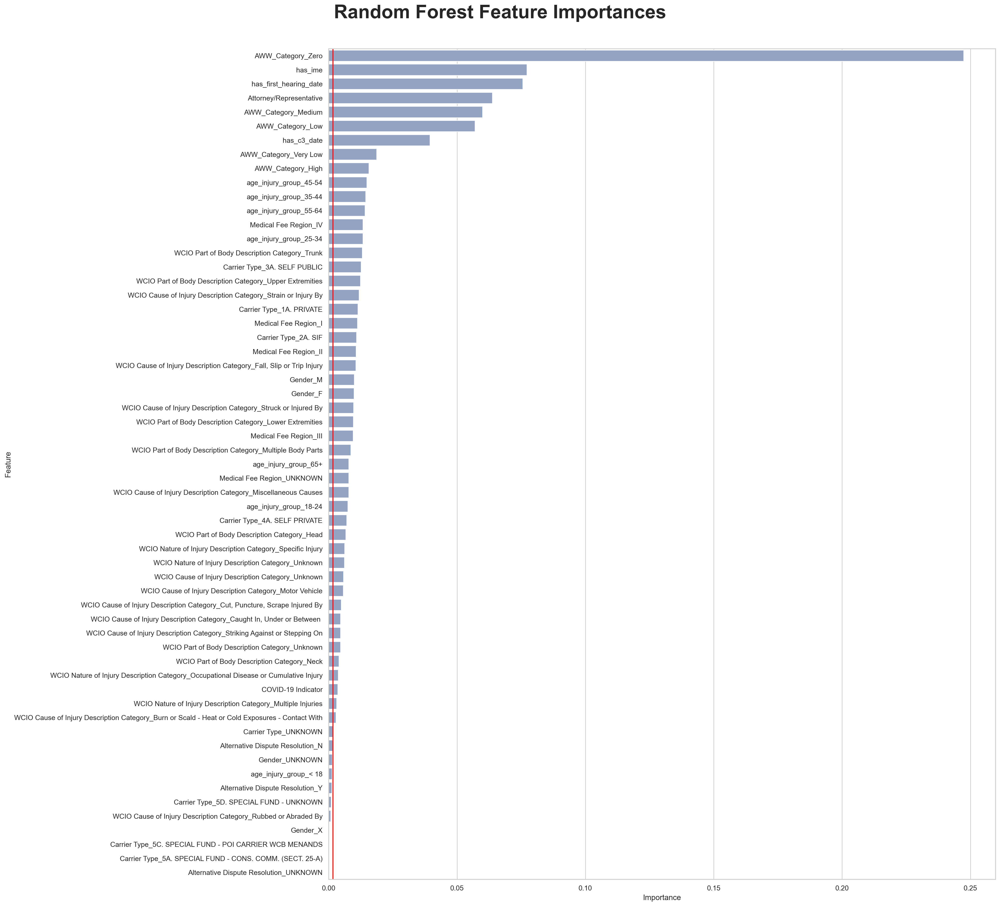

In [44]:
sns.set(font_scale=1)
sns.set_style("whitegrid")

plt.figure(figsize=(23, 20), dpi=200)
sns.barplot(data=feature_importance_df, y='Feature', x='Importance', color=sns.color_palette("Set2")[2], orient="h")

plt.axvline(x=0.0017, color='red')  
plt.tight_layout(pad=4)

plt.suptitle("Random Forest Feature Importances", fontweight="bold", fontsize=30, y=1.015)

plt.show()

In [158]:
rf_selected_cat = feature_importance_df[feature_importance_df['Importance'] > 0.0017]['Feature'].tolist()


### Ridge Regression

In [115]:

# Initialize the Logistic Regression model with L2 regularization and 'lbfgs' solver
model = LogisticRegression(penalty='l2', solver='lbfgs', max_iter=1000)

model.fit(X_train_num, target_train)
coef = pd.Series(model.coef_[0], index=X_train_num.columns)

coef


Age at Injury                            -0.079318
Average Weekly Wage                      -1.672011
Birth Year                                0.300042
Number of Dependents                      0.061478
Diff_days_assembly_accident               0.314932
Average Weekly Wage log                  -3.619170
Carrier Name_Frqc                         0.051254
County of Injury_Frqc                     0.213070
District Name_Frqc                        0.621563
Industry Code Description_Frqc           -1.494014
WCIO Part Of Body Description_Frqc       -0.055040
WCIO Nature of Injury Description_Frqc   -1.324022
WCIO Cause of Injury Description_Frqc    -0.019917
AWW_Category_Frqc                         1.972472
age_injury_group_Frqc                     0.631039
Zip_Main_Characteristic_Frqc             -0.003002
Accident_Day_Of_Week_Frqc                -0.234505
Assembly_Day_Of_Week_Frqc                -0.125549
Accident_Year                            -1.608816
Accident_Month                 

In [116]:
def plot_importance(coef,name):
    imp_coef = coef.sort_values()
    plt.figure(figsize=(8,10))
    imp_coef.plot(kind = "barh")
    plt.title("Feature importance using " + name + " Model")
    plt.show()

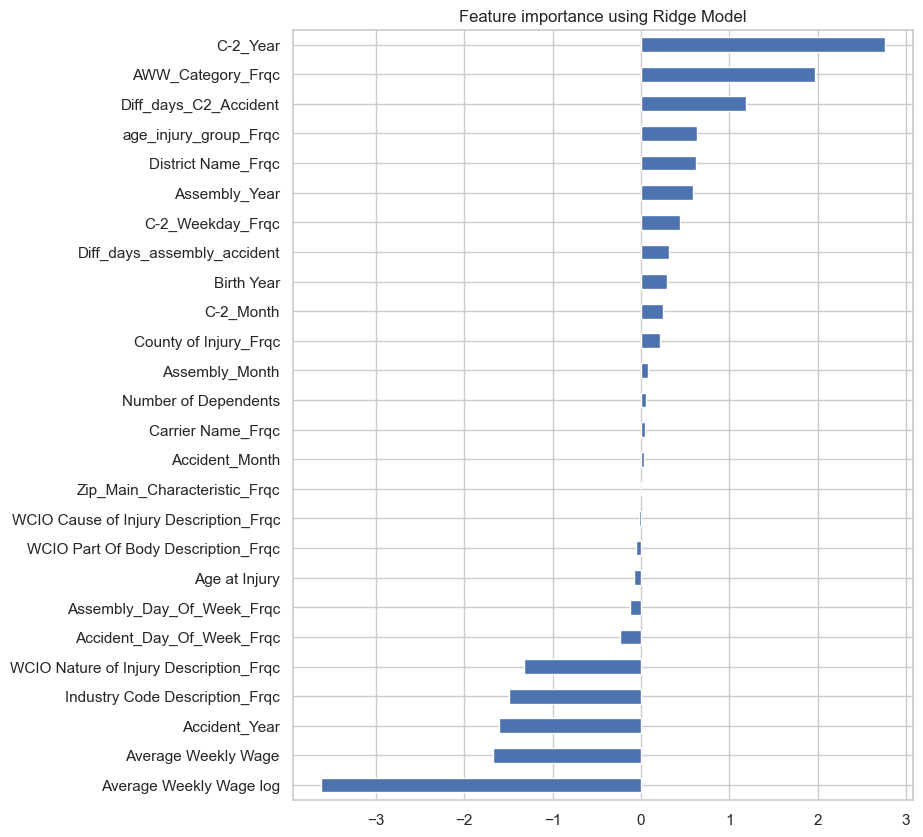

In [117]:
plot_importance(coef,'Ridge') 

According to Lasso, we should discard the following features:
- WCIO Cause of Injury Description_Frqc
- Zip_Main_Characteristics_Frqc
- Accident month


## Decision tree - Feature Importance

In [48]:
gini_importance = DecisionTreeClassifier().fit(X_train_all, target_train).feature_importances_
entropy_importance = DecisionTreeClassifier(criterion='entropy').fit(X_train_all, target_train).feature_importances_

<Axes: xlabel='Value', ylabel='Col'>

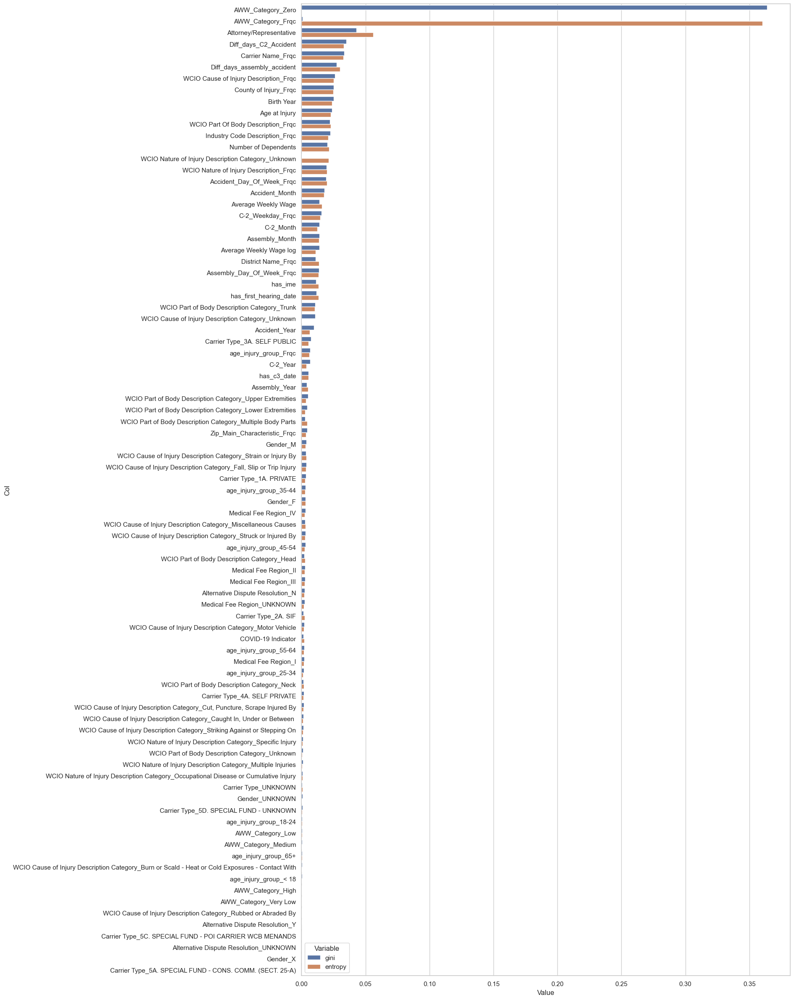

In [49]:
zippy = pd.DataFrame(zip(gini_importance, entropy_importance), columns = ['gini','entropy'])
zippy['col'] = X_train_all.columns
tidy = zippy.melt(id_vars='col').rename(columns=str.title)
tidy.sort_values(['Value'], ascending = False, inplace = True)

plt.figure(figsize=(15,30))
sns.barplot(y='Col', x='Value', hue='Variable', data=tidy)

<a class="anchor" id="2.4">

## Class specific analysis - Open-ended section
    
</a>


**Mutual Information**

In [50]:
for target_class in df_target_train['Claim Injury Type'].unique():

    binary_target = (df_target_train['Claim Injury Type'] == target_class).astype(int)
    
    mi_scores = mutual_info_classif(X_train_cat, binary_target)
    
    mi_df = pd.DataFrame({
        'Feature': X_train_cat.columns,
        'MI Score': mi_scores
    })
    
    mi_df = mi_df.sort_values(by='MI Score', ascending=False)
    
    print(f"MI scores for class \033[1;35m{target_class}\033[1;0m:")
    print(mi_df) 
    print("\n")


MI scores for class 1:
                                              Feature  MI Score
51                                  AWW_Category_Zero  0.419678
0                             Attorney/Representative  0.177483
4                                             has_ime  0.168600
3                              has_first_hearing_date  0.150918
49                                AWW_Category_Medium  0.126405
1                                         has_c3_date  0.112333
48                                   AWW_Category_Low  0.096817
17                                           Gender_M  0.042407
5                    Alternative Dispute Resolution_N  0.038881
8                            Carrier Type_1A. PRIVATE  0.037751
34  WCIO Nature of Injury Description Category_Spe...  0.037540
47                                  AWW_Category_High  0.033447
50                              AWW_Category_Very Low  0.032447
23                              Medical Fee Region_IV  0.029324
16               

In [51]:
df_target_train0 = (df_target_train == 0).astype(int)
df_target_train1 = (df_target_train == 1).astype(int)
df_target_train2 = (df_target_train == 2).astype(int)
df_target_train3 = (df_target_train == 3).astype(int)
df_target_train4 = (df_target_train == 4).astype(int)
df_target_train5 = (df_target_train == 5).astype(int)
df_target_train6 = (df_target_train == 6).astype(int)
df_target_train7 = (df_target_train == 7).astype(int)

target_train0 = df_target_train0['Claim Injury Type'].to_numpy()
target_train1 = df_target_train1['Claim Injury Type'].to_numpy()
target_train2 = df_target_train2['Claim Injury Type'].to_numpy()
target_train3 = df_target_train3['Claim Injury Type'].to_numpy()
target_train4 = df_target_train4['Claim Injury Type'].to_numpy()
target_train5 = df_target_train5['Claim Injury Type'].to_numpy()
target_train6 = df_target_train6['Claim Injury Type'].to_numpy()
target_train7 = df_target_train7['Claim Injury Type'].to_numpy()

### Class 0

**Spearman correlation matrix**

<Axes: >

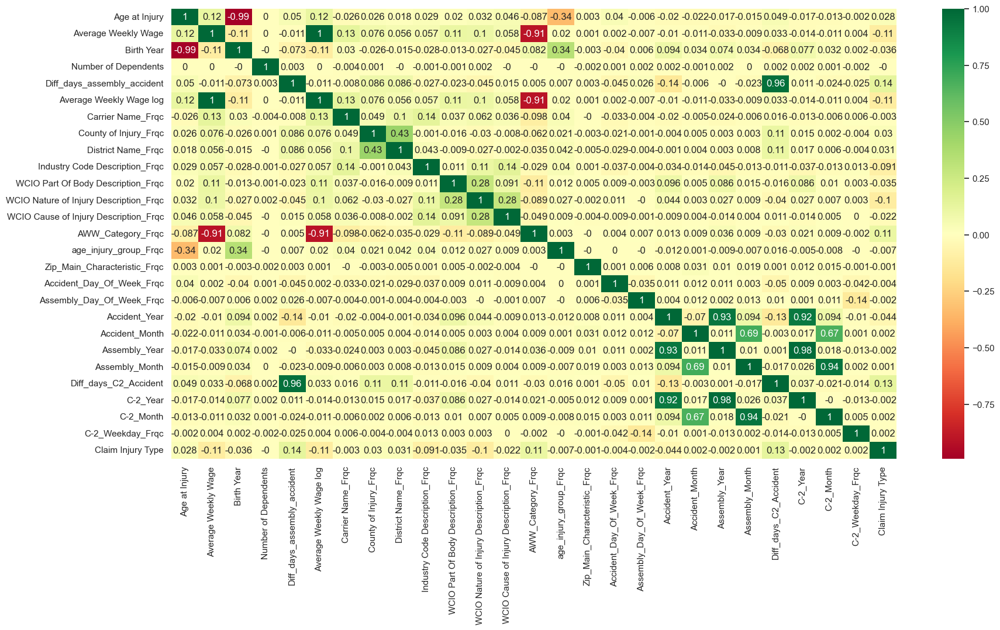

In [53]:
plt.figure(figsize=(20,10))
X_train_and_target= pd.concat([X_train_num, df_target_train0], axis=1)
sns.heatmap(X_train_and_target.corr(method='spearman').round(3), annot=True, cmap="RdYlGn")

**Cramer's V**

In [54]:
#Heatmap of Cramér's V
df_cramers = pd.concat([X_train_cat, df_target_train0], axis=1)
results = pd.DataFrame(index=df_cramers.columns, columns=df_cramers.columns)

for var1 in df_cramers.columns:
    for var2 in df_cramers.columns:
        if var1 != var2:
            results.loc[var1, var2] = cramers_v(df_cramers[var1], df_cramers[var2])
        else:
            results.loc[var1, var2] = 1

results = results.astype(float)
last_row_index = results.index[-1]
last_row = results.iloc[-1, :] 
lower_triangle_last_row = last_row.loc[:last_row_index]
pd.DataFrame(lower_triangle_last_row.sort_values(ascending=False)).T

,Claim Injury Type,WCIO Nature of Injury Description Category_Unknown,WCIO Cause of Injury Description Category_Unknown,WCIO Part of Body Description Category_Unknown,WCIO Nature of Injury Description Category_Specific Injury,AWW_Category_Zero,has_ime,AWW_Category_Medium,WCIO Part of Body Description Category_Upper Extremities,AWW_Category_Low,WCIO Cause of Injury Description Category_Struck or Injured By,"WCIO Cause of Injury Description Category_Fall, Slip or Trip Injury",WCIO Part of Body Description Category_Lower Extremities,has_c3_date,"WCIO Cause of Injury Description Category_Cut, Puncture, Scrape Injured By",WCIO Cause of Injury Description Category_Strain or Injury By,Carrier Type_UNKNOWN,WCIO Part of Body Description Category_Trunk,AWW_Category_High,WCIO Part of Body Description Category_Head,AWW_Category_Very Low,has_first_hearing_date,Medical Fee Region_IV,Attorney/Representative,Medical Fee Region_I,Gender_F,WCIO Cause of Injury Description Category_Striking Against or Stepping On,age_injury_group_18-24,Gender_M,age_injury_group_35-44,"WCIO Cause of Injury Description Category_Caught In, Under or Between",age_injury_group_25-34,WCIO Part of Body Description Category_Multiple Body Parts,Medical Fee Region_II,WCIO Cause of Injury Description Category_Motor Vehicle,Medical Fee Region_UNKNOWN,Carrier Type_4A. SELF PRIVATE,WCIO Cause of Injury Description Category_Burn or Scald - Heat or Cold Exposures - Contact With,COVID-19 Indicator,age_injury_group_55-64,Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A),WCIO Part of Body Description Category_Neck,Gender_UNKNOWN,Alternative Dispute Resolution_N,Alternative Dispute Resolution_Y,Carrier Type_5D. SPECIAL FUND - UNKNOWN,Carrier Type_1A. PRIVATE,Carrier Type_3A. SELF PUBLIC,age_injury_group_45-54,WCIO Cause of Injury Description Category_Miscellaneous Causes,age_injury_group_65+,age_injury_group_< 18,Carrier Type_2A. SIF,Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS,WCIO Cause of Injury Description Category_Rubbed or Abraded By,Medical Fee Region_III,WCIO Nature of Injury Description Category_Occupational Disease or Cumulative Injury,WCIO Nature of Injury Description Category_Multiple Injuries,Gender_X,Alternative Dispute Resolution_UNKNOWN
Claim Injury Type,1.0,0.486949,0.486897,0.448921,0.244745,0.110787,0.071644,0.062285,0.059596,0.054622,0.052893,0.050328,0.047611,0.038626,0.03561,0.03418,0.03286,0.03232,0.032117,0.0307,0.030628,0.02893,0.027052,0.026818,0.026145,0.023079,0.023021,0.022769,0.021634,0.020101,0.019915,0.019467,0.018361,0.018109,0.01701,0.015862,0.015172,0.014553,0.011743,0.010658,0.008971,0.007612,0.007508,0.007396,0.007385,0.005975,0.005461,0.004582,0.004551,0.004396,0.004321,0.003878,0.003507,0.003496,0.002718,0.001095,0.000575,0.000315,0.000093,0.0


**Select K-Best: Numerical Variables**

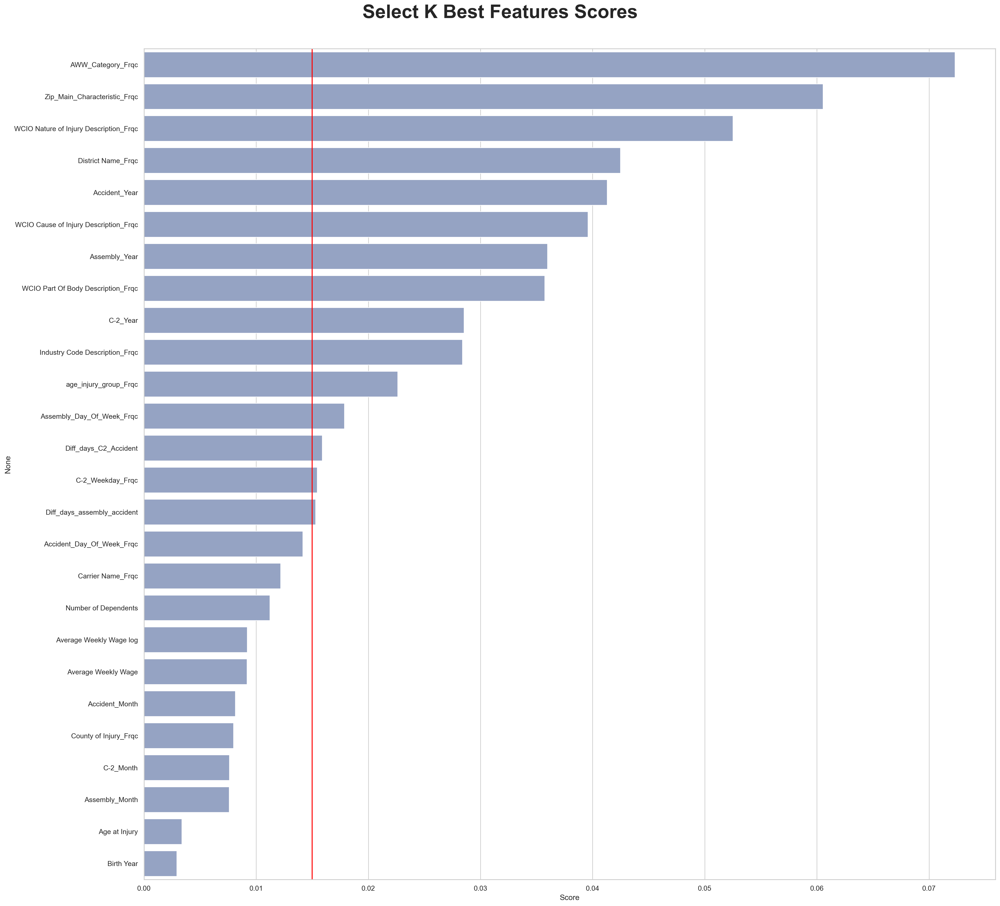

In [172]:
X_new2 = SelectKBest(score_func=mutual_info_classif,k='all').fit(X_train_num, target_train0)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=0.015, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Select K-Best: Categorical Variables**

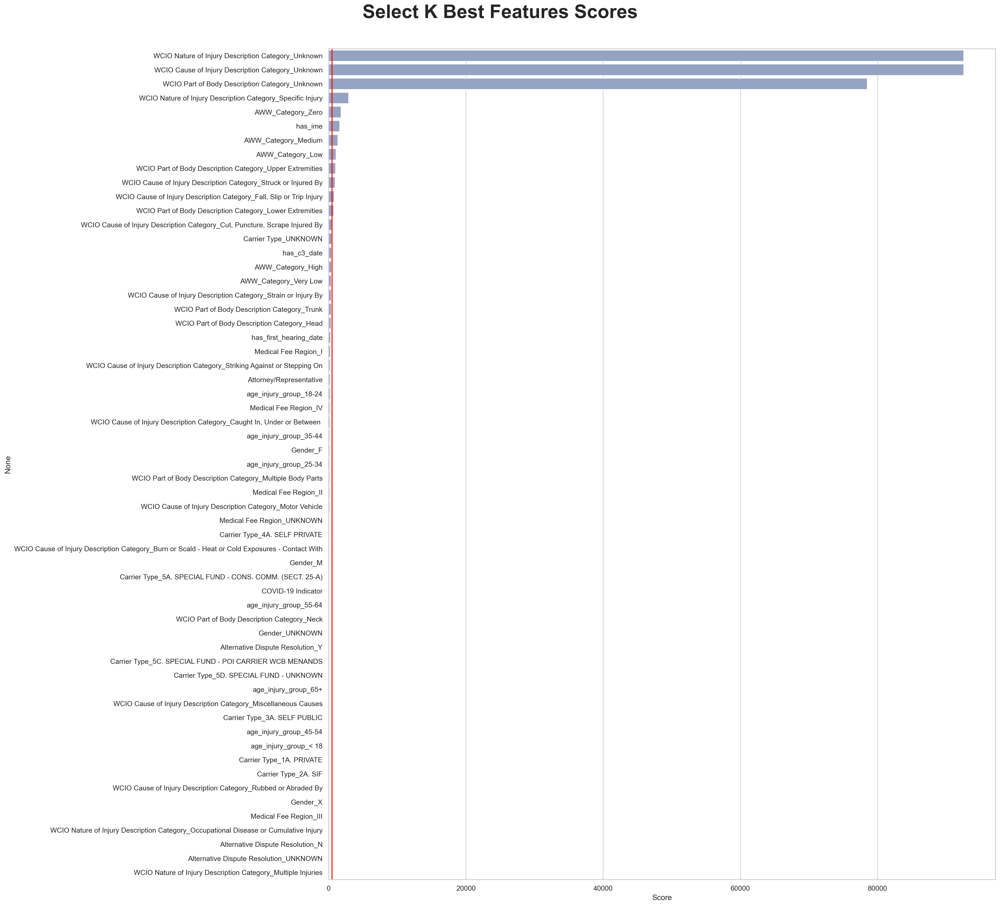

In [168]:
X_new2 = SelectKBest(score_func=chi2,k='all').fit(X_train_cat, target_train0)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=500, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Random Forest- Categorical Variables**

Threshould used: 0.017 (= 1 / 59 features)

In [57]:
rf = RandomForestClassifier()
rf.fit(X_train_cat, df_target_train0)
importances = rf.feature_importances_

In [58]:
feature_importance_df = pd.DataFrame({
    'Feature': X_train_cat.columns,
    'Importance': importances
})

feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

feature_importance_df

,Feature,Importance
35,WCIO Nature of Injury Description Category_Unk...,0.127320
46,WCIO Cause of Injury Description Category_Unknown,0.103878
30,WCIO Part of Body Description Category_Unknown,0.087818
1,has_c3_date,0.040980
34,WCIO Nature of Injury Description Category_Spe...,0.038416
0,Attorney/Representative,0.032733
3,has_first_hearing_date,0.029569
9,Carrier Type_2A. SIF,0.028983
8,Carrier Type_1A. PRIVATE,0.028060
7,Alternative Dispute Resolution_Y,0.026693


**Ridge Regression**

In [59]:
# Initialize the Logistic Regression model with L2 regularization and 'lbfgs' solver
model = LogisticRegression(penalty='l2', solver='lbfgs', max_iter=1000)

model.fit(X_train_num, target_train0)

coef = pd.Series(model.coef_[0], index=X_train_num.columns)


coef

Age at Injury                             0.466742
Average Weekly Wage                      -0.904939
Birth Year                               -2.134261
Number of Dependents                      0.018519
Diff_days_assembly_accident               1.076601
Average Weekly Wage log                  -2.900728
Carrier Name_Frqc                         0.527192
County of Injury_Frqc                     0.500197
District Name_Frqc                        0.384449
Industry Code Description_Frqc           -1.865764
WCIO Part Of Body Description_Frqc       -0.195946
WCIO Nature of Injury Description_Frqc   -1.801803
WCIO Cause of Injury Description_Frqc    -0.081686
AWW_Category_Frqc                         1.826317
age_injury_group_Frqc                     0.729558
Zip_Main_Characteristic_Frqc             -0.024014
Accident_Day_Of_Week_Frqc                -0.202721
Assembly_Day_Of_Week_Frqc                -0.299009
Accident_Year                            -2.349629
Accident_Month                 

#### Overall features importance for class 0

***Best Categorical:*** 'WCIO Nature of Injury Description Category_Specific Injury', 'WCIO Nature of Injury Description Category_Unknown'<br>
***Best Numerical:*** 'Average Weekly Wage log', 'Diff_days_assembly_accident'<br>

***Worst Categorical:*** 'age_injury_group_< 18', 'WCIO Nature of Injury Description Category_Multiple Injuries', 'Alternative Dispute Resolution_UNKNOWN' <br>
***Worst Numerical:*** 'Birth Year', 'Number of Dependents' <br>

### Class 1

**Spearman correlation matrix**

<Axes: >

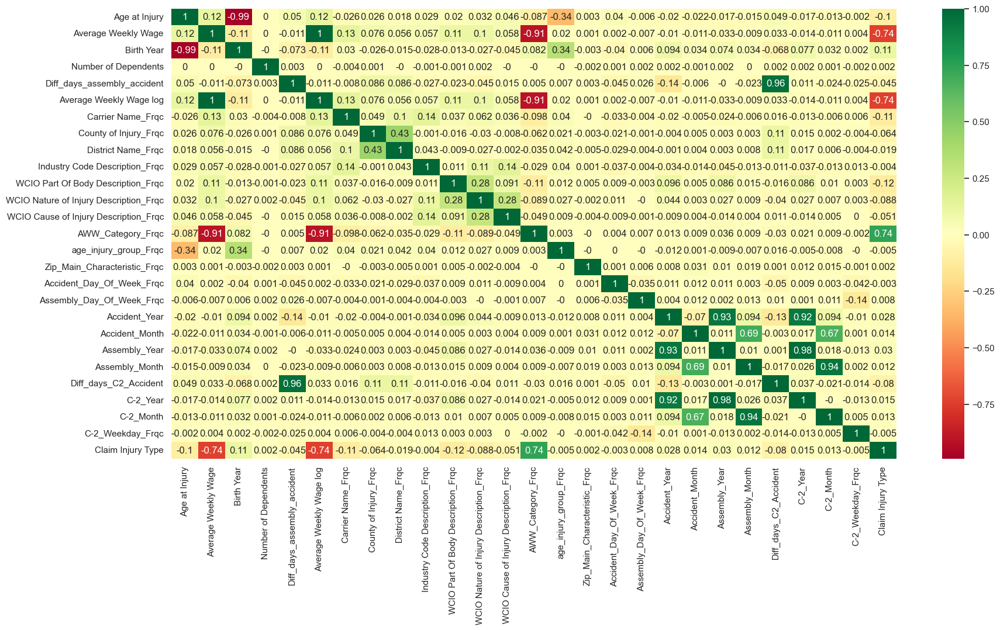

In [60]:
plt.figure(figsize=(20,10))
X_train_and_target= pd.concat([X_train_num, df_target_train1], axis=1)
sns.heatmap(X_train_and_target.corr(method='spearman').round(3), annot=True, cmap="RdYlGn")

**Cramer's V**

In [61]:
#Heatmap of Cramér's V
df_cramers = pd.concat([X_train_cat, df_target_train1], axis=1)
results = pd.DataFrame(index=df_cramers.columns, columns=df_cramers.columns)

for var1 in df_cramers.columns:
    for var2 in df_cramers.columns:
        if var1 != var2:
            results.loc[var1, var2] = cramers_v(df_cramers[var1], df_cramers[var2])
        else:
            results.loc[var1, var2] = 1

results = results.astype(float)
last_row_index = results.index[-1]
last_row = results.iloc[-1, :] 
lower_triangle_last_row = last_row.loc[:last_row_index]
pd.DataFrame(lower_triangle_last_row.sort_values(ascending=False)).T

,Claim Injury Type,AWW_Category_Zero,Attorney/Representative,has_ime,has_first_hearing_date,AWW_Category_Medium,has_c3_date,AWW_Category_Low,AWW_Category_High,AWW_Category_Very Low,"WCIO Cause of Injury Description Category_Cut, Puncture, Scrape Injured By",Carrier Type_2A. SIF,WCIO Cause of Injury Description Category_Strain or Injury By,WCIO Part of Body Description Category_Head,age_injury_group_18-24,"WCIO Cause of Injury Description Category_Fall, Slip or Trip Injury",WCIO Cause of Injury Description Category_Miscellaneous Causes,Gender_M,Carrier Type_1A. PRIVATE,COVID-19 Indicator,Gender_F,WCIO Cause of Injury Description Category_Motor Vehicle,Alternative Dispute Resolution_N,Alternative Dispute Resolution_Y,WCIO Nature of Injury Description Category_Occupational Disease or Cumulative Injury,WCIO Cause of Injury Description Category_Burn or Scald - Heat or Cold Exposures - Contact With,WCIO Cause of Injury Description Category_Struck or Injured By,WCIO Part of Body Description Category_Lower Extremities,age_injury_group_25-34,age_injury_group_45-54,Medical Fee Region_IV,Carrier Type_4A. SELF PRIVATE,age_injury_group_55-64,WCIO Nature of Injury Description Category_Specific Injury,Carrier Type_UNKNOWN,Medical Fee Region_I,WCIO Cause of Injury Description Category_Striking Against or Stepping On,WCIO Part of Body Description Category_Neck,age_injury_group_35-44,WCIO Part of Body Description Category_Multiple Body Parts,Gender_UNKNOWN,WCIO Part of Body Description Category_Upper Extremities,WCIO Nature of Injury Description Category_Multiple Injuries,Medical Fee Region_II,Carrier Type_3A. SELF PUBLIC,Medical Fee Region_UNKNOWN,WCIO Part of Body Description Category_Trunk,age_injury_group_65+,age_injury_group_< 18,Carrier Type_5D. SPECIAL FUND - UNKNOWN,WCIO Nature of Injury Description Category_Unknown,WCIO Cause of Injury Description Category_Unknown,Medical Fee Region_III,WCIO Part of Body Description Category_Unknown,Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A),Alternative Dispute Resolution_UNKNOWN,Gender_X,Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS,"WCIO Cause of Injury Description Category_Caught In, Under or Between",WCIO Cause of Injury Description Category_Rubbed or Abraded By
Claim Injury Type,1.0,0.764936,0.532761,0.511524,0.493203,0.428695,0.42172,0.37962,0.218487,0.214007,0.132957,0.113519,0.110431,0.098334,0.097496,0.088344,0.083394,0.080131,0.078782,0.077131,0.075572,0.070505,0.065767,0.065712,0.060011,0.058282,0.055847,0.05418,0.049357,0.048756,0.042184,0.041066,0.040118,0.038923,0.038859,0.037045,0.033918,0.030729,0.029363,0.027747,0.026225,0.024618,0.02362,0.02085,0.020255,0.015148,0.012665,0.012223,0.009263,0.006924,0.005529,0.005458,0.004958,0.002938,0.001864,0.001783,0.00138,0.00115,0.000827,0.00035


**Select K-Best: Numerical Variables**

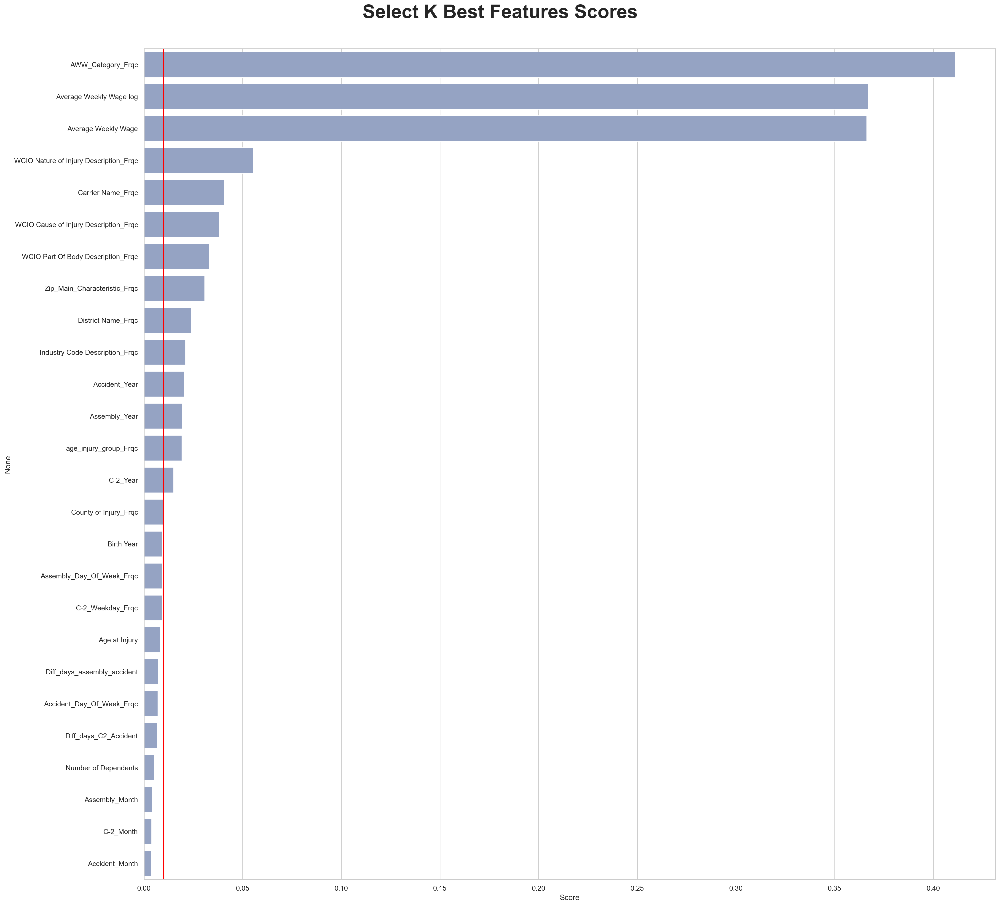

In [173]:
X_new2 = SelectKBest(score_func=mutual_info_classif,k='all').fit(X_train_num, target_train1)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=0.01, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Select K-Best: Categorical Variables**

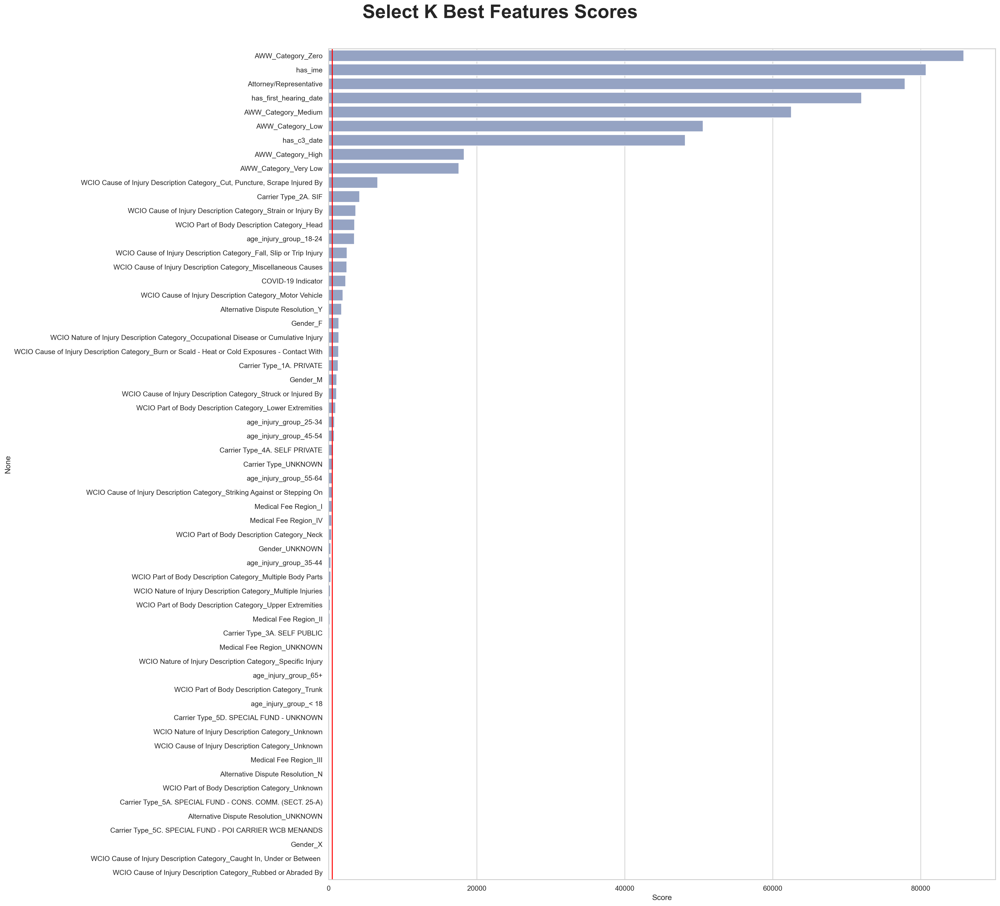

In [174]:
X_new2 = SelectKBest(score_func=chi2,k='all').fit(X_train_cat, target_train1)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=500, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Random Forest- Categorical Variables**

Threshould used: 0.017 (= 1 / 59 features)

In [64]:
rf = RandomForestClassifier()
rf.fit(X_train_cat, df_target_train1)
importances = rf.feature_importances_

In [65]:
feature_importance_df = pd.DataFrame({
    'Feature': X_train_cat.columns,
    'Importance': importances
})

feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

feature_importance_df

,Feature,Importance
51,AWW_Category_Zero,0.325218
4,has_ime,0.108416
0,Attorney/Representative,0.100516
3,has_first_hearing_date,0.080051
48,AWW_Category_Low,0.080024
49,AWW_Category_Medium,0.071710
1,has_c3_date,0.033588
50,AWW_Category_Very Low,0.024446
47,AWW_Category_High,0.020960
9,Carrier Type_2A. SIF,0.006280


**Ridge Regression**

In [66]:
# Initialize the Logistic Regression model with L2 regularization and 'lbfgs' solver
model = LogisticRegression(penalty='l2', solver='lbfgs', max_iter=1000)

model.fit(X_train_num, target_train1)

coef = pd.Series(model.coef_[0], index=X_train_num.columns)


coef

Age at Injury                            -0.765876
Average Weekly Wage                      -1.239379
Birth Year                                0.216033
Number of Dependents                      0.032094
Diff_days_assembly_accident              -3.830148
Average Weekly Wage log                  -4.928046
Carrier Name_Frqc                        -0.547955
County of Injury_Frqc                    -0.364320
District Name_Frqc                        0.307486
Industry Code Description_Frqc            0.474475
WCIO Part Of Body Description_Frqc       -0.364204
WCIO Nature of Injury Description_Frqc   -0.059017
WCIO Cause of Injury Description_Frqc    -0.081425
AWW_Category_Frqc                         3.171637
age_injury_group_Frqc                    -0.208904
Zip_Main_Characteristic_Frqc              0.038431
Accident_Day_Of_Week_Frqc                 0.012052
Assembly_Day_Of_Week_Frqc                 0.077400
Accident_Year                             1.551634
Accident_Month                 

#### Overall features importance for class 1

***Best Categorical:*** 'AWW_Category_Zero' <br>
***Best Numerical:*** 'Average Weekly Wage log', 'AWW_Category_Frqc', 'Diff_days_assembly_accident'<br>

***Worst Categorical:*** 'WCIO Cause of Injury Description Category_Rubbed or Abraded By', 'Alternative Dispute Resolution_UNKNOWN', 'Gender_F'  <br>
***Worst Numerical:*** 'Number of Dependents', 'Industry Code Description_Frqc', 'Age at Injury' <br>

### Class 2

**Spearman correlation matrix**

<Axes: >

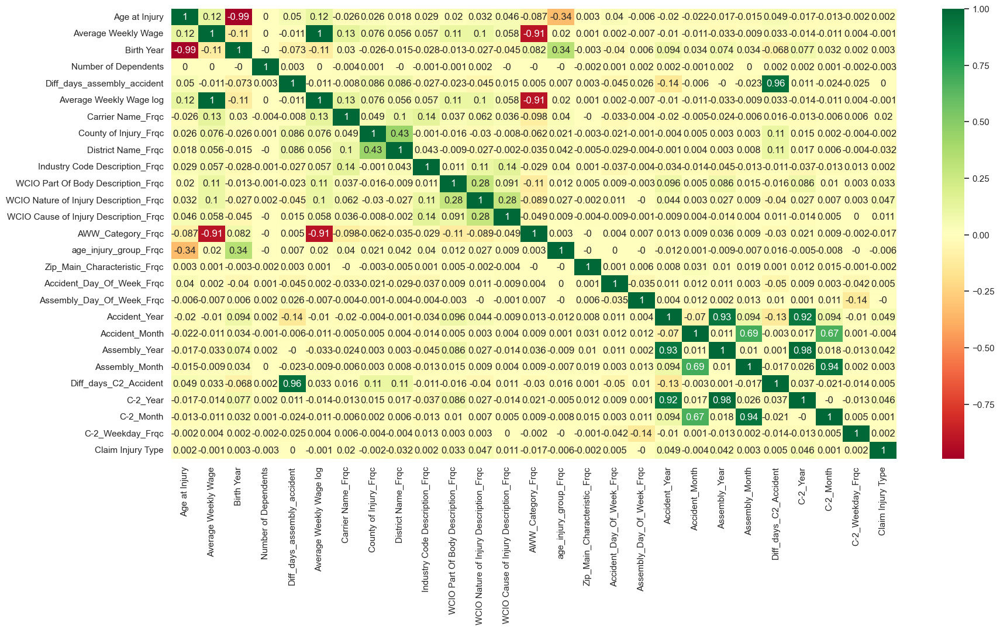

In [67]:
plt.figure(figsize=(20,10))
X_train_and_target= pd.concat([X_train_num, df_target_train2], axis=1)
sns.heatmap(X_train_and_target.corr(method='spearman').round(3), annot=True, cmap="RdYlGn")

**Cramer's V**

In [68]:
#Heatmap of Cramér's V
df_cramers = pd.concat([X_train_cat, df_target_train2], axis=1)
results = pd.DataFrame(index=df_cramers.columns, columns=df_cramers.columns)

for var1 in df_cramers.columns:
    for var2 in df_cramers.columns:
        if var1 != var2:
            results.loc[var1, var2] = cramers_v(df_cramers[var1], df_cramers[var2])
        else:
            results.loc[var1, var2] = 1

results = results.astype(float)
last_row_index = results.index[-1]
last_row = results.iloc[-1, :] 
lower_triangle_last_row = last_row.loc[:last_row_index]
pd.DataFrame(lower_triangle_last_row.sort_values(ascending=False)).T

,Claim Injury Type,WCIO Cause of Injury Description Category_Unknown,WCIO Nature of Injury Description Category_Unknown,WCIO Part of Body Description Category_Unknown,has_first_hearing_date,WCIO Nature of Injury Description Category_Specific Injury,AWW_Category_Very Low,WCIO Cause of Injury Description Category_Motor Vehicle,Carrier Type_2A. SIF,WCIO Cause of Injury Description Category_Miscellaneous Causes,Carrier Type_1A. PRIVATE,has_ime,COVID-19 Indicator,WCIO Nature of Injury Description Category_Occupational Disease or Cumulative Injury,Alternative Dispute Resolution_N,Alternative Dispute Resolution_Y,age_injury_group_< 18,"WCIO Cause of Injury Description Category_Fall, Slip or Trip Injury",WCIO Part of Body Description Category_Multiple Body Parts,AWW_Category_Medium,Carrier Type_UNKNOWN,Medical Fee Region_UNKNOWN,WCIO Part of Body Description Category_Upper Extremities,"WCIO Cause of Injury Description Category_Cut, Puncture, Scrape Injured By",Carrier Type_3A. SELF PUBLIC,Medical Fee Region_I,has_c3_date,WCIO Cause of Injury Description Category_Strain or Injury By,WCIO Cause of Injury Description Category_Struck or Injured By,WCIO Part of Body Description Category_Trunk,Medical Fee Region_IV,Carrier Type_4A. SELF PRIVATE,AWW_Category_Zero,WCIO Part of Body Description Category_Neck,WCIO Part of Body Description Category_Lower Extremities,WCIO Part of Body Description Category_Head,Gender_UNKNOWN,Medical Fee Region_III,WCIO Nature of Injury Description Category_Multiple Injuries,age_injury_group_25-34,WCIO Cause of Injury Description Category_Burn or Scald - Heat or Cold Exposures - Contact With,AWW_Category_Low,age_injury_group_55-64,Carrier Type_5D. SPECIAL FUND - UNKNOWN,Gender_X,"WCIO Cause of Injury Description Category_Caught In, Under or Between",Medical Fee Region_II,Attorney/Representative,age_injury_group_35-44,Gender_F,age_injury_group_18-24,Gender_M,age_injury_group_65+,age_injury_group_45-54,Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A),AWW_Category_High,WCIO Cause of Injury Description Category_Striking Against or Stepping On,Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS,WCIO Cause of Injury Description Category_Rubbed or Abraded By,Alternative Dispute Resolution_UNKNOWN
Claim Injury Type,1.0,0.057637,0.057624,0.052322,0.050227,0.047305,0.04635,0.040529,0.040314,0.036807,0.03673,0.028361,0.026899,0.026754,0.024879,0.024858,0.023081,0.02061,0.019992,0.01932,0.019226,0.019124,0.016407,0.015894,0.014777,0.014338,0.013436,0.013202,0.009497,0.009254,0.008242,0.008156,0.007976,0.007484,0.006611,0.006561,0.006531,0.005623,0.005616,0.004823,0.004705,0.004427,0.004403,0.004001,0.003403,0.002748,0.002426,0.002317,0.002222,0.001727,0.001062,0.000579,0.000569,0.000552,0.000393,0.000388,0.00025,0.0,0.0,0.0


**Select K-Best: Numerical Variables**

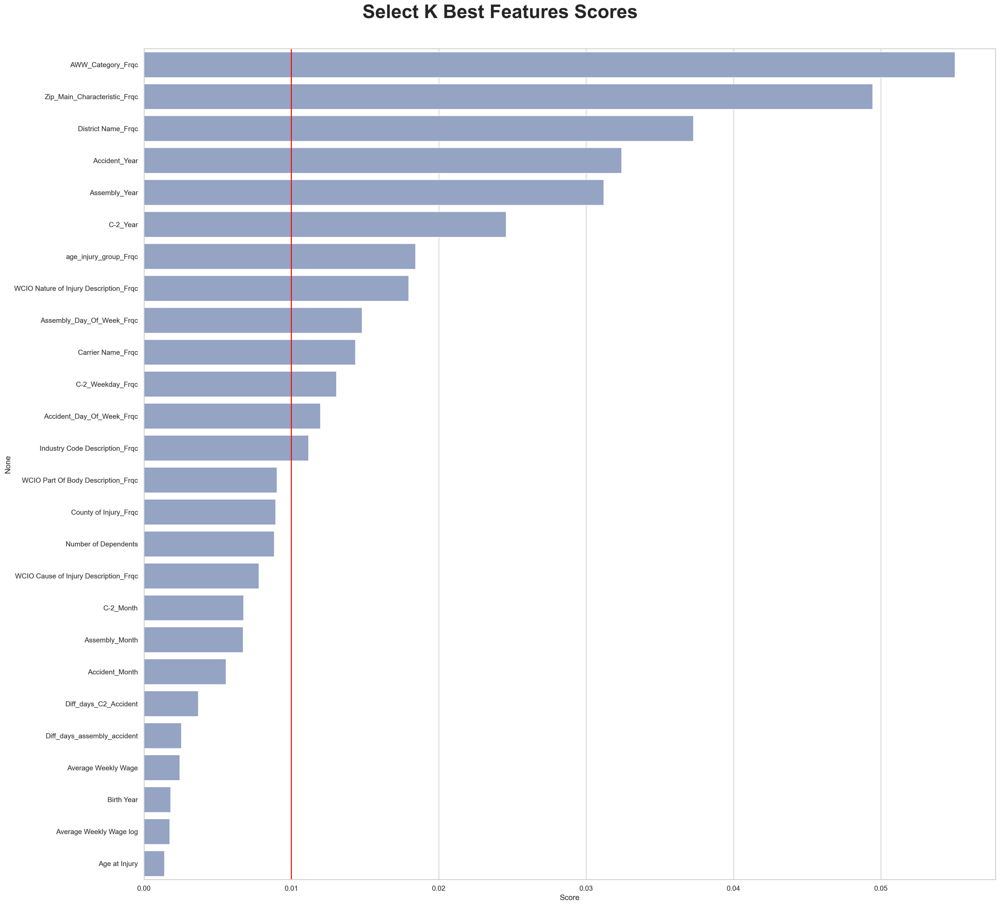

In [170]:
X_new2 = SelectKBest(score_func=mutual_info_classif,k='all').fit(X_train_num, target_train2)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=0.01, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Select K-Best: Categorical Variables**

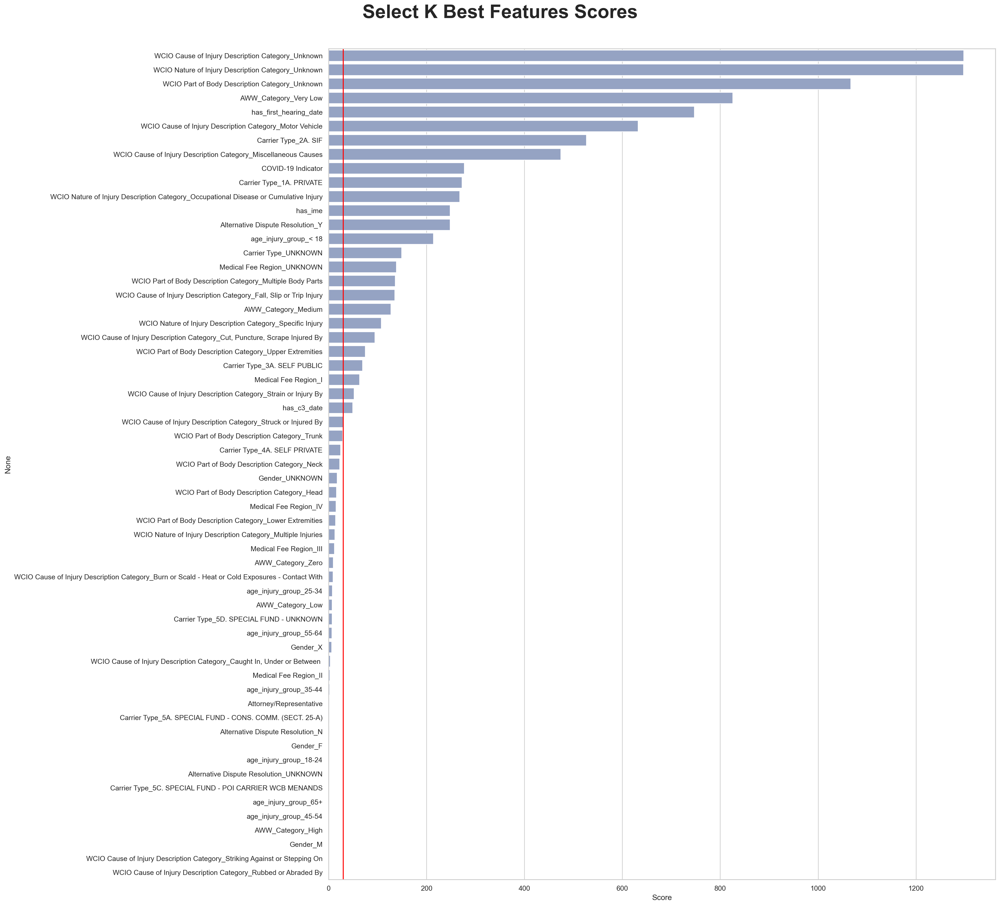

In [175]:
X_new2 = SelectKBest(score_func=chi2,k='all').fit(X_train_cat, target_train2)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=30, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Random Forest- Categorical Variables**

Threshould used: 0.017 (= 1 / 59 features)

In [71]:
rf = RandomForestClassifier()
rf.fit(X_train_cat, df_target_train2)
importances = rf.feature_importances_

In [72]:
feature_importance_df = pd.DataFrame({
    'Feature': X_train_cat.columns,
    'Importance': importances
})

feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

feature_importance_df

,Feature,Importance
1,has_c3_date,4.963669e-02
0,Attorney/Representative,4.885027e-02
3,has_first_hearing_date,4.394800e-02
4,has_ime,4.215969e-02
55,age_injury_group_45-54,3.661873e-02
54,age_injury_group_35-44,3.599552e-02
56,age_injury_group_55-64,3.489127e-02
53,age_injury_group_25-34,3.466679e-02
51,AWW_Category_Zero,3.425396e-02
23,Medical Fee Region_IV,2.834043e-02


**Ridge Regression**

In [73]:
# Initialize the Logistic Regression model with L2 regularization and 'lbfgs' solver
model = LogisticRegression(penalty='l2', solver='lbfgs', max_iter=1000)

model.fit(X_train_num, target_train2)

coef = pd.Series(model.coef_[0], index=X_train_num.columns)


coef

Age at Injury                             0.016240
Average Weekly Wage                       0.319171
Birth Year                               -0.022290
Number of Dependents                     -0.027999
Diff_days_assembly_accident              -1.618279
Average Weekly Wage log                  -2.622557
Carrier Name_Frqc                         0.301126
County of Injury_Frqc                     0.176346
District Name_Frqc                       -0.361815
Industry Code Description_Frqc            0.003553
WCIO Part Of Body Description_Frqc        0.168491
WCIO Nature of Injury Description_Frqc    0.307755
WCIO Cause of Injury Description_Frqc    -0.016352
AWW_Category_Frqc                        -2.322035
age_injury_group_Frqc                    -0.027978
Zip_Main_Characteristic_Frqc             -0.036481
Accident_Day_Of_Week_Frqc                 0.046652
Assembly_Day_Of_Week_Frqc                 0.033631
Accident_Year                             0.862108
Accident_Month                 

#### Overall features importance for class 2

***Best Categorical:*** 'AWW_Category_Zero', 'WCIO Cause of Injury Description Category_Unknown', 'has_c3_date'<br>
***Best Numerical:*** 'WCIO Nature of Injury Description_Frqc', 'Birth Year'<br>

***Worst Categorical:*** 'Alternative Dispute Resolution_UNKNOWN' <br>
***Worst Numerical:*** 'Age at Injury', 'WCIO Cause of Injury Description Category_Rubbed or Abraded By' <br>

### Class 3

**Spearman correlation matrix**

<Axes: >

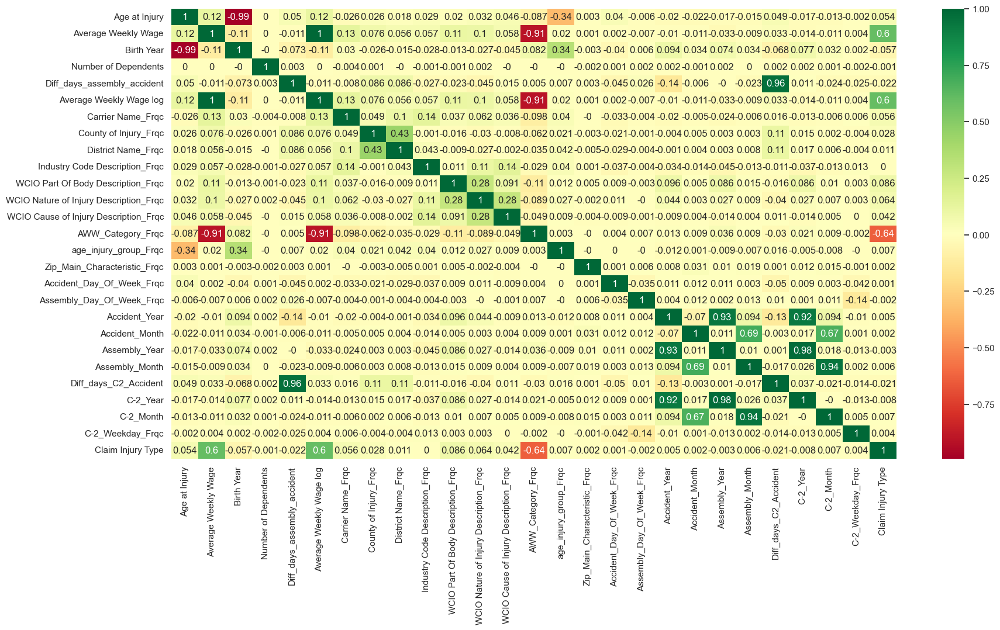

In [74]:
plt.figure(figsize=(20,10))
X_train_and_target= pd.concat([X_train_num, df_target_train3], axis=1)
sns.heatmap(X_train_and_target.corr(method='spearman').round(3), annot=True, cmap="RdYlGn")

**Cramer's V**

In [75]:
#Heatmap of Cramér's V
df_cramers = pd.concat([X_train_cat, df_target_train3], axis=1)
results = pd.DataFrame(index=df_cramers.columns, columns=df_cramers.columns)

for var1 in df_cramers.columns:
    for var2 in df_cramers.columns:
        if var1 != var2:
            results.loc[var1, var2] = cramers_v(df_cramers[var1], df_cramers[var2])
        else:
            results.loc[var1, var2] = 1

results = results.astype(float)
last_row_index = results.index[-1]
last_row = results.iloc[-1, :] 
lower_triangle_last_row = last_row.loc[:last_row_index]
pd.DataFrame(lower_triangle_last_row.sort_values(ascending=False)).T

,Claim Injury Type,AWW_Category_Zero,AWW_Category_Low,has_ime,has_first_hearing_date,Attorney/Representative,AWW_Category_Medium,has_c3_date,AWW_Category_Very Low,AWW_Category_High,WCIO Nature of Injury Description Category_Unknown,WCIO Cause of Injury Description Category_Unknown,Carrier Type_2A. SIF,"WCIO Cause of Injury Description Category_Cut, Puncture, Scrape Injured By",WCIO Part of Body Description Category_Trunk,WCIO Part of Body Description Category_Unknown,"WCIO Cause of Injury Description Category_Fall, Slip or Trip Injury",WCIO Part of Body Description Category_Head,Carrier Type_3A. SELF PUBLIC,WCIO Cause of Injury Description Category_Strain or Injury By,WCIO Cause of Injury Description Category_Motor Vehicle,WCIO Nature of Injury Description Category_Specific Injury,WCIO Part of Body Description Category_Upper Extremities,age_injury_group_18-24,WCIO Cause of Injury Description Category_Miscellaneous Causes,Gender_M,Alternative Dispute Resolution_N,Alternative Dispute Resolution_Y,WCIO Part of Body Description Category_Neck,Gender_F,WCIO Cause of Injury Description Category_Burn or Scald - Heat or Cold Exposures - Contact With,age_injury_group_45-54,WCIO Part of Body Description Category_Lower Extremities,WCIO Cause of Injury Description Category_Struck or Injured By,Carrier Type_UNKNOWN,WCIO Part of Body Description Category_Multiple Body Parts,WCIO Nature of Injury Description Category_Occupational Disease or Cumulative Injury,age_injury_group_25-34,WCIO Nature of Injury Description Category_Multiple Injuries,Medical Fee Region_I,Medical Fee Region_UNKNOWN,COVID-19 Indicator,WCIO Cause of Injury Description Category_Striking Against or Stepping On,Gender_UNKNOWN,age_injury_group_35-44,Medical Fee Region_IV,age_injury_group_55-64,age_injury_group_< 18,Carrier Type_5D. SPECIAL FUND - UNKNOWN,Carrier Type_4A. SELF PRIVATE,Medical Fee Region_III,Carrier Type_1A. PRIVATE,age_injury_group_65+,"WCIO Cause of Injury Description Category_Caught In, Under or Between",WCIO Cause of Injury Description Category_Rubbed or Abraded By,Medical Fee Region_II,Gender_X,Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A),Alternative Dispute Resolution_UNKNOWN,Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS
Claim Injury Type,1.0,0.648965,0.390484,0.353314,0.340949,0.328063,0.312963,0.260207,0.211787,0.13434,0.091166,0.091076,0.090964,0.086349,0.085631,0.082568,0.079453,0.071461,0.068675,0.063418,0.059604,0.054878,0.054083,0.051239,0.046908,0.040769,0.039841,0.039808,0.038377,0.037731,0.033876,0.032359,0.030635,0.03032,0.029413,0.027218,0.026952,0.026829,0.026071,0.023727,0.021559,0.021206,0.019351,0.01694,0.016773,0.01626,0.016059,0.015601,0.012872,0.012681,0.006558,0.006098,0.004835,0.003604,0.003596,0.003297,0.002137,0.000574,0.000574,0.0


**Select K-Best: Numerical Variables**

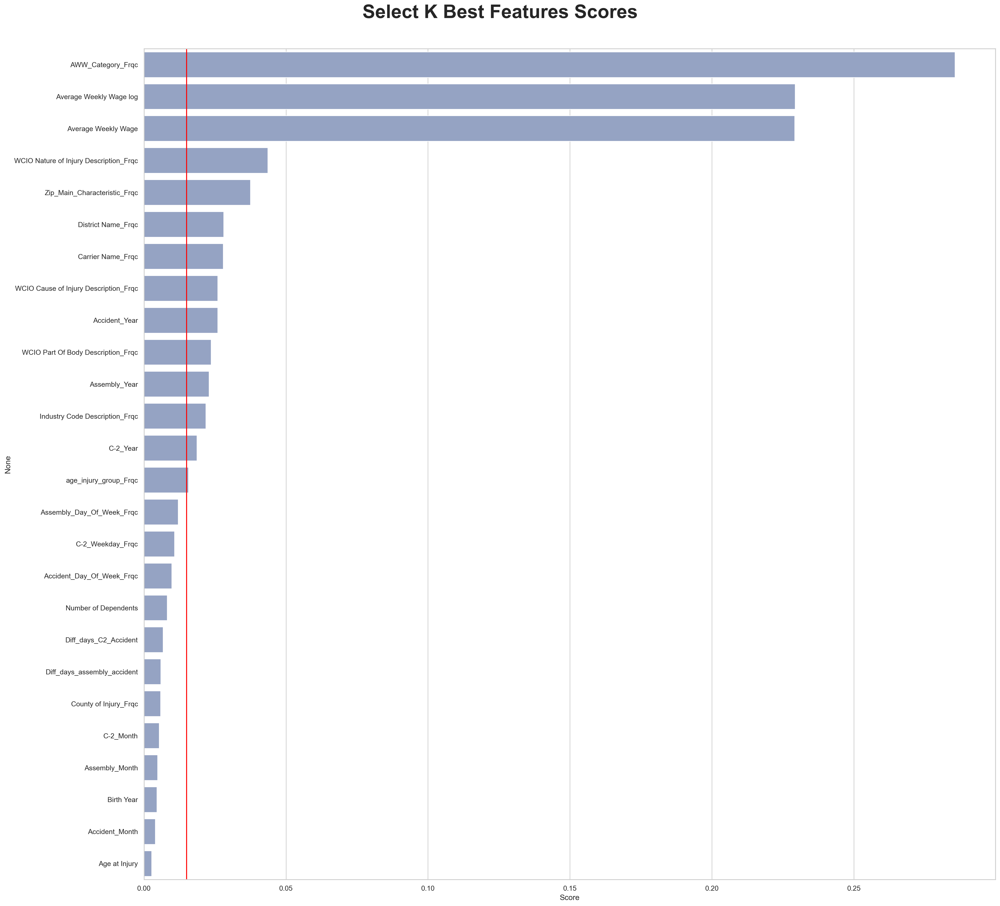

In [176]:
X_new2 = SelectKBest(score_func=mutual_info_classif,k='all').fit(X_train_num, target_train3)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=0.015, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Select K-Best: Categorical Variables**

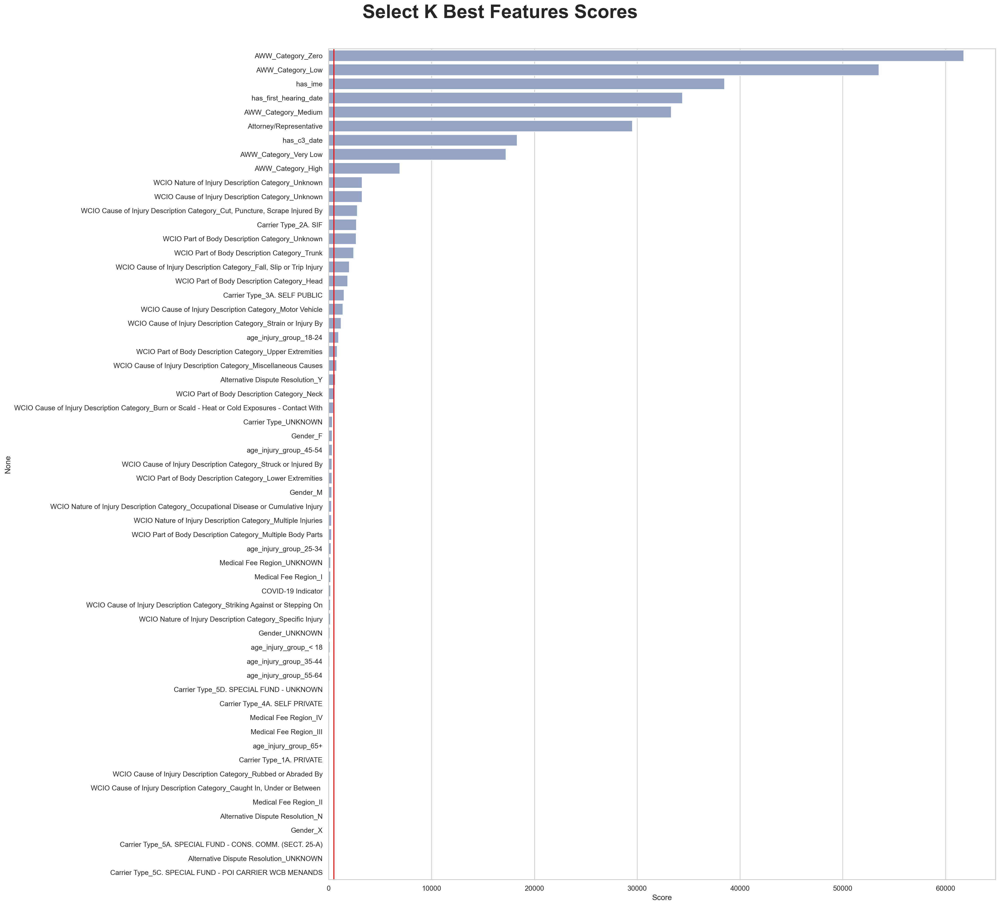

In [77]:
X_new2 = SelectKBest(score_func=chi2,k='all').fit(X_train_cat, target_train3)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=500, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Random Forest- Categorical Variables**

Threshould used: 0.017 (= 1 / 59 features)

In [78]:
rf = RandomForestClassifier()
rf.fit(X_train_cat, df_target_train3)
importances = rf.feature_importances_

In [79]:
feature_importance_df = pd.DataFrame({
    'Feature': X_train_cat.columns,
    'Importance': importances
})

feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

feature_importance_df

,Feature,Importance
51,AWW_Category_Zero,2.666156e-01
48,AWW_Category_Low,9.562250e-02
49,AWW_Category_Medium,6.394357e-02
4,has_ime,6.084927e-02
3,has_first_hearing_date,5.227122e-02
0,Attorney/Representative,5.157064e-02
1,has_c3_date,3.519351e-02
50,AWW_Category_Very Low,2.929006e-02
47,AWW_Category_High,1.838209e-02
10,Carrier Type_3A. SELF PUBLIC,1.474214e-02


**Ridge Regression**

In [80]:
# Initialize the Logistic Regression model with L2 regularization and 'lbfgs' solver
model = LogisticRegression(penalty='l2', solver='lbfgs', max_iter=1000)

model.fit(X_train_num, target_train3)

coef = pd.Series(model.coef_[0], index=X_train_num.columns)


coef

Age at Injury                             0.298978
Average Weekly Wage                      -3.529845
Birth Year                                0.350363
Number of Dependents                     -0.014150
Diff_days_assembly_accident               4.775328
Average Weekly Wage log                   3.427336
Carrier Name_Frqc                         0.209197
County of Injury_Frqc                    -0.057133
District Name_Frqc                       -0.005569
Industry Code Description_Frqc           -0.305909
WCIO Part Of Body Description_Frqc        0.088659
WCIO Nature of Injury Description_Frqc   -0.083836
WCIO Cause of Injury Description_Frqc     0.246293
AWW_Category_Frqc                        -2.121390
age_injury_group_Frqc                     0.146307
Zip_Main_Characteristic_Frqc              0.011860
Accident_Day_Of_Week_Frqc                 0.012097
Assembly_Day_Of_Week_Frqc                 0.118675
Accident_Year                            -1.806150
Accident_Month                 

#### Overall features importance for class 3

***Best Categorical:*** 'AWW_Category_Zero'<br>
***Best Numerical:*** 'AWW_Category_Frqc', 'Diff_days_assembly_accident'<br>

***Worst Categorical:*** 'age_injury_group_< 18', 'Alternative Dispute Resolution_UNKNOWN', 'Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS' <br>
***Worst Numerical:*** 'Industry Code Description_Frqc', 'Age at Injury', 'Number of Dependents' <br>

### Class 4

**Spearman correlation matrix**

<Axes: >

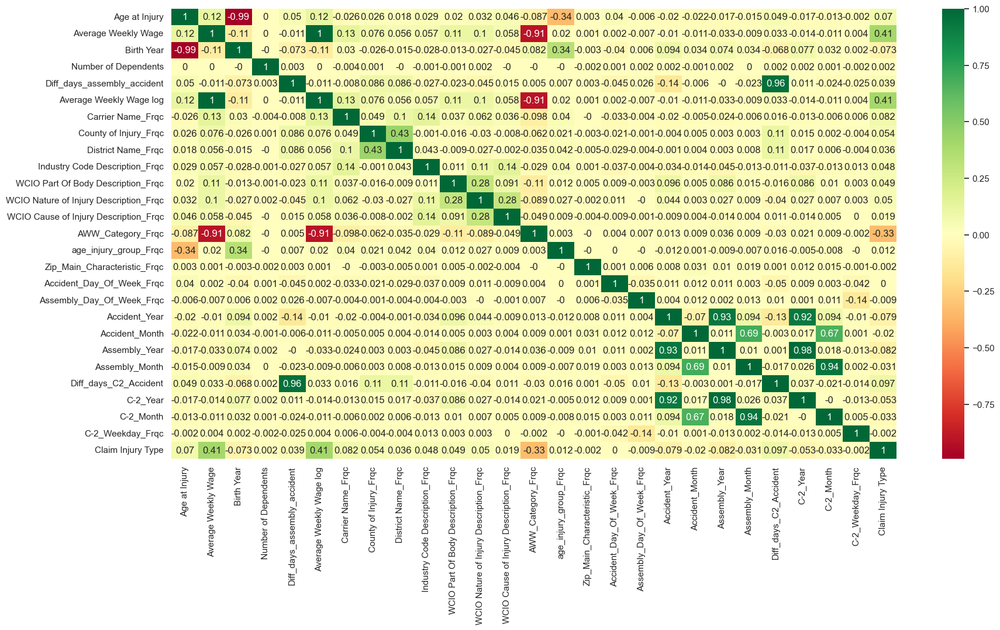

In [81]:
plt.figure(figsize=(20,10))
X_train_and_target= pd.concat([X_train_num, df_target_train4], axis=1)
sns.heatmap(X_train_and_target.corr(method='spearman').round(3), annot=True, cmap="RdYlGn")

**Cramer's V**

In [82]:
#Heatmap of Cramér's V
df_cramers = pd.concat([X_train_cat, df_target_train4], axis=1)
results = pd.DataFrame(index=df_cramers.columns, columns=df_cramers.columns)

for var1 in df_cramers.columns:
    for var2 in df_cramers.columns:
        if var1 != var2:
            results.loc[var1, var2] = cramers_v(df_cramers[var1], df_cramers[var2])
        else:
            results.loc[var1, var2] = 1

results = results.astype(float)
last_row_index = results.index[-1]
last_row = results.iloc[-1, :] 
lower_triangle_last_row = last_row.loc[:last_row_index]
pd.DataFrame(lower_triangle_last_row.sort_values(ascending=False)).T

,Claim Injury Type,has_ime,Attorney/Representative,AWW_Category_Zero,AWW_Category_Medium,has_c3_date,has_first_hearing_date,AWW_Category_High,Carrier Type_3A. SELF PUBLIC,WCIO Part of Body Description Category_Trunk,WCIO Part of Body Description Category_Upper Extremities,WCIO Cause of Injury Description Category_Strain or Injury By,Carrier Type_1A. PRIVATE,AWW_Category_Low,WCIO Part of Body Description Category_Lower Extremities,age_injury_group_18-24,COVID-19 Indicator,Gender_M,Gender_F,"WCIO Cause of Injury Description Category_Cut, Puncture, Scrape Injured By",WCIO Nature of Injury Description Category_Specific Injury,WCIO Part of Body Description Category_Head,WCIO Nature of Injury Description Category_Unknown,WCIO Cause of Injury Description Category_Unknown,WCIO Part of Body Description Category_Unknown,Medical Fee Region_IV,WCIO Cause of Injury Description Category_Burn or Scald - Heat or Cold Exposures - Contact With,Carrier Type_4A. SELF PRIVATE,WCIO Nature of Injury Description Category_Occupational Disease or Cumulative Injury,WCIO Cause of Injury Description Category_Struck or Injured By,"WCIO Cause of Injury Description Category_Fall, Slip or Trip Injury",WCIO Cause of Injury Description Category_Miscellaneous Causes,Medical Fee Region_I,age_injury_group_45-54,age_injury_group_55-64,Medical Fee Region_II,WCIO Part of Body Description Category_Neck,age_injury_group_25-34,Alternative Dispute Resolution_N,Alternative Dispute Resolution_Y,age_injury_group_35-44,Carrier Type_UNKNOWN,WCIO Cause of Injury Description Category_Motor Vehicle,WCIO Cause of Injury Description Category_Striking Against or Stepping On,age_injury_group_< 18,Gender_UNKNOWN,WCIO Nature of Injury Description Category_Multiple Injuries,WCIO Part of Body Description Category_Multiple Body Parts,AWW_Category_Very Low,Carrier Type_5D. SPECIAL FUND - UNKNOWN,age_injury_group_65+,"WCIO Cause of Injury Description Category_Caught In, Under or Between",Carrier Type_2A. SIF,Medical Fee Region_III,WCIO Cause of Injury Description Category_Rubbed or Abraded By,Medical Fee Region_UNKNOWN,Gender_X,Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS,Alternative Dispute Resolution_UNKNOWN,Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A)
Claim Injury Type,1.0,0.389146,0.388682,0.368021,0.311497,0.287097,0.257322,0.187919,0.12809,0.121068,0.101838,0.098088,0.086848,0.074292,0.074125,0.073341,0.067383,0.067217,0.064699,0.058332,0.056454,0.053193,0.049719,0.049692,0.047362,0.044668,0.035828,0.034324,0.034037,0.033759,0.031683,0.030268,0.029552,0.029303,0.028829,0.025539,0.024197,0.023563,0.020393,0.020376,0.019078,0.01661,0.016172,0.015533,0.015419,0.015035,0.010418,0.010408,0.008885,0.007457,0.007347,0.006502,0.005497,0.004918,0.004293,0.003353,0.00273,0.0,0.0,0.0


**Select K-Best: Numerical Variables**

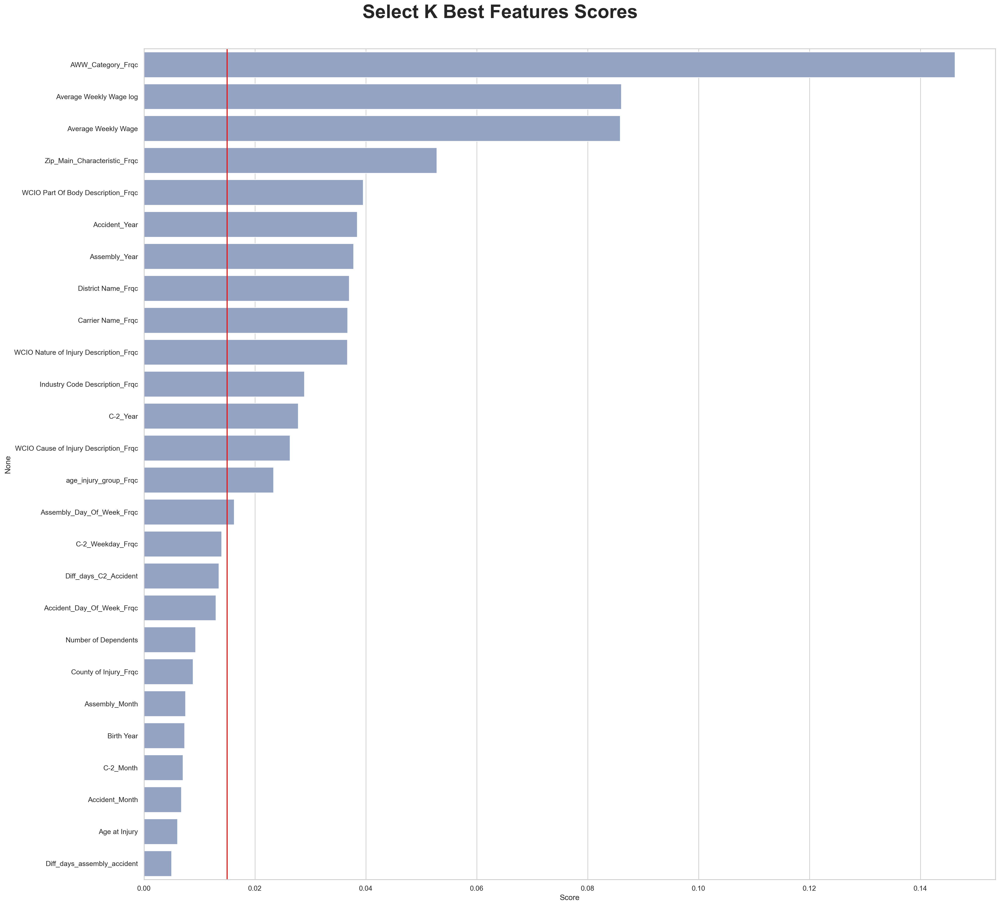

In [177]:
X_new2 = SelectKBest(score_func=mutual_info_classif,k='all').fit(X_train_num, target_train4)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=0.015, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Select K-Best: Categorical Variables**

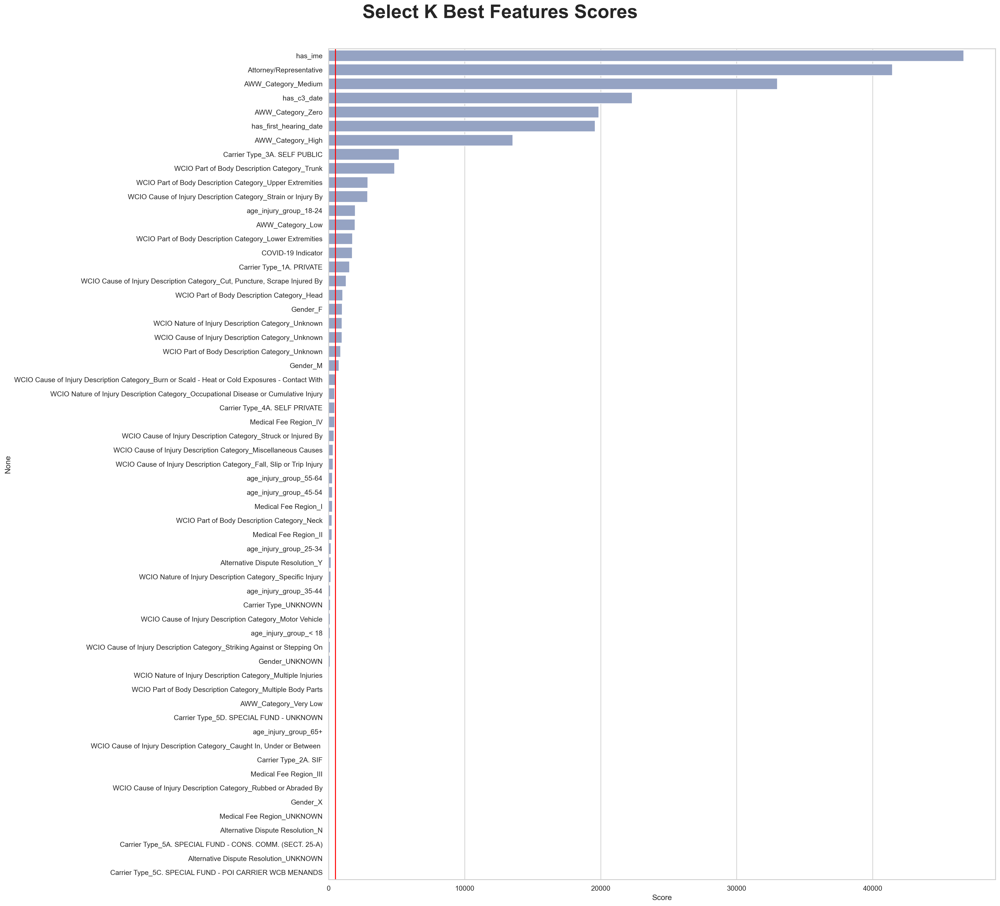

In [84]:
X_new2 = SelectKBest(score_func=chi2,k='all').fit(X_train_cat, target_train4)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=500, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Random Forest- Categorical Variables**

Threshould used: 0.017 (= 1 / 59 features)

In [85]:
rf = RandomForestClassifier()
rf.fit(X_train_cat, df_target_train4)
importances = rf.feature_importances_

In [86]:
feature_importance_df = pd.DataFrame({
    'Feature': X_train_cat.columns,
    'Importance': importances
})

feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

feature_importance_df

,Feature,Importance
4,has_ime,1.048162e-01
0,Attorney/Representative,1.011188e-01
51,AWW_Category_Zero,6.765539e-02
3,has_first_hearing_date,5.840822e-02
1,has_c3_date,5.273287e-02
49,AWW_Category_Medium,5.095472e-02
29,WCIO Part of Body Description Category_Trunk,3.419876e-02
10,Carrier Type_3A. SELF PUBLIC,3.287733e-02
31,WCIO Part of Body Description Category_Upper E...,3.215374e-02
43,WCIO Cause of Injury Description Category_Stra...,2.409423e-02


**Ridge Regression**

In [87]:
# Initialize the Logistic Regression model with L2 regularization and 'lbfgs' solver
model = LogisticRegression(penalty='l2', solver='lbfgs', max_iter=1000)

model.fit(X_train_num, target_train4)

coef = pd.Series(model.coef_[0], index=X_train_num.columns)


coef

Age at Injury                             -3.872632
Average Weekly Wage                        0.539619
Birth Year                                -6.417316
Number of Dependents                       0.030188
Diff_days_assembly_accident               -7.215371
Average Weekly Wage log                    6.152149
Carrier Name_Frqc                         -0.242050
County of Injury_Frqc                      0.231149
District Name_Frqc                        -0.050073
Industry Code Description_Frqc             0.289174
WCIO Part Of Body Description_Frqc         0.218241
WCIO Nature of Injury Description_Frqc     0.211838
WCIO Cause of Injury Description_Frqc     -0.269380
AWW_Category_Frqc                          1.776015
age_injury_group_Frqc                      0.182013
Zip_Main_Characteristic_Frqc              -0.063383
Accident_Day_Of_Week_Frqc                 -0.022754
Assembly_Day_Of_Week_Frqc                 -0.325467
Accident_Year                             -5.555157
Accident_Mon

#### Overall features importance for class 4

***Best Categorical:*** 'AWW_Category_Zero', 'has_ime', 'Attorney/Representative'<br>
***Best Numerical:*** 'Average Weekly Wage'<br>

***Worst Categorical:*** Carrier Type: 5A, 5C, 5D <br>
***Worst Numerical:*** 'District Name_Frqc', 'Number of Dependents' <br>

### Class 5

**Spearman correlation matrix**

<Axes: >

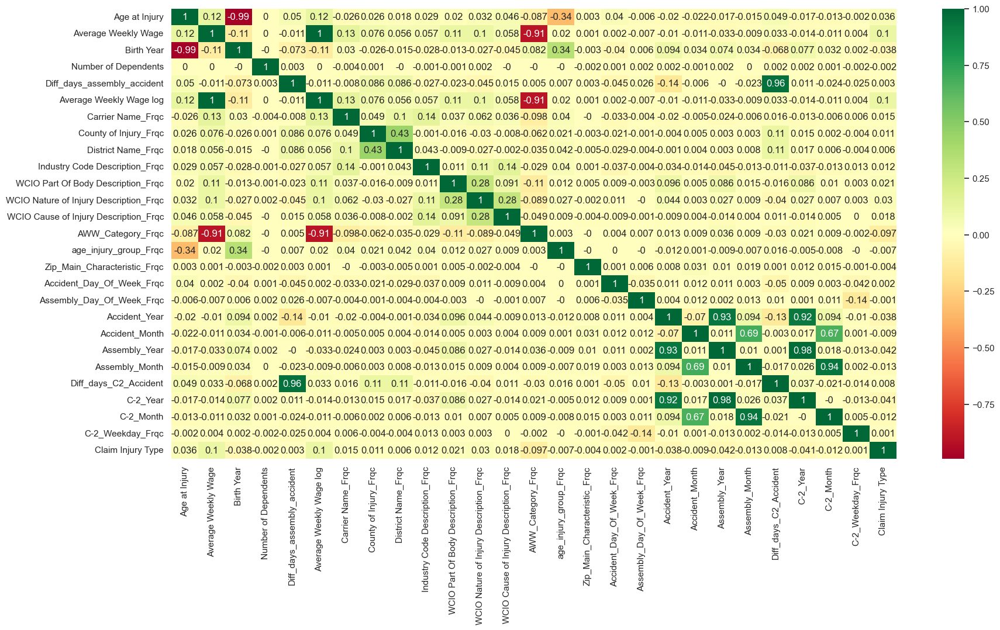

In [88]:
plt.figure(figsize=(20,10))
X_train_and_target= pd.concat([X_train_num, df_target_train5], axis=1)
sns.heatmap(X_train_and_target.corr(method='spearman').round(3), annot=True, cmap="RdYlGn")

**Cramer's V**

In [89]:
#Heatmap of Cramér's V
df_cramers = pd.concat([X_train_cat, df_target_train5], axis=1)
results = pd.DataFrame(index=df_cramers.columns, columns=df_cramers.columns)

for var1 in df_cramers.columns:
    for var2 in df_cramers.columns:
        if var1 != var2:
            results.loc[var1, var2] = cramers_v(df_cramers[var1], df_cramers[var2])
        else:
            results.loc[var1, var2] = 1

results = results.astype(float)
last_row_index = results.index[-1]
last_row = results.iloc[-1, :] 
lower_triangle_last_row = last_row.loc[:last_row_index]
pd.DataFrame(lower_triangle_last_row.sort_values(ascending=False)).T

,Claim Injury Type,has_ime,has_first_hearing_date,Attorney/Representative,AWW_Category_Zero,has_c3_date,AWW_Category_Medium,AWW_Category_Low,WCIO Part of Body Description Category_Neck,WCIO Part of Body Description Category_Trunk,AWW_Category_High,WCIO Cause of Injury Description Category_Motor Vehicle,WCIO Part of Body Description Category_Upper Extremities,age_injury_group_18-24,"WCIO Cause of Injury Description Category_Cut, Puncture, Scrape Injured By",age_injury_group_55-64,WCIO Part of Body Description Category_Lower Extremities,age_injury_group_25-34,Carrier Type_2A. SIF,WCIO Nature of Injury Description Category_Occupational Disease or Cumulative Injury,"WCIO Cause of Injury Description Category_Fall, Slip or Trip Injury",COVID-19 Indicator,WCIO Cause of Injury Description Category_Strain or Injury By,Carrier Type_1A. PRIVATE,WCIO Nature of Injury Description Category_Specific Injury,WCIO Cause of Injury Description Category_Miscellaneous Causes,age_injury_group_45-54,WCIO Nature of Injury Description Category_Unknown,WCIO Cause of Injury Description Category_Unknown,AWW_Category_Very Low,"WCIO Cause of Injury Description Category_Caught In, Under or Between",WCIO Nature of Injury Description Category_Multiple Injuries,WCIO Part of Body Description Category_Head,Medical Fee Region_I,WCIO Cause of Injury Description Category_Burn or Scald - Heat or Cold Exposures - Contact With,WCIO Cause of Injury Description Category_Striking Against or Stepping On,WCIO Part of Body Description Category_Unknown,Medical Fee Region_UNKNOWN,WCIO Part of Body Description Category_Multiple Body Parts,age_injury_group_65+,Carrier Type_3A. SELF PUBLIC,Alternative Dispute Resolution_N,Alternative Dispute Resolution_Y,WCIO Cause of Injury Description Category_Struck or Injured By,Medical Fee Region_IV,Carrier Type_4A. SELF PRIVATE,age_injury_group_< 18,Carrier Type_UNKNOWN,Gender_UNKNOWN,Medical Fee Region_III,WCIO Cause of Injury Description Category_Rubbed or Abraded By,Medical Fee Region_II,Gender_M,Carrier Type_5D. SPECIAL FUND - UNKNOWN,age_injury_group_35-44,Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS,Alternative Dispute Resolution_UNKNOWN,Gender_F,Gender_X,Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A)
Claim Injury Type,1.0,0.146036,0.142457,0.122458,0.10376,0.087665,0.066593,0.050414,0.046178,0.040237,0.032245,0.031306,0.026271,0.023591,0.021747,0.020181,0.019632,0.018954,0.016782,0.016761,0.016226,0.016043,0.016041,0.015011,0.014973,0.014583,0.014364,0.014301,0.014294,0.012965,0.011696,0.011595,0.009813,0.009011,0.00871,0.008564,0.007715,0.007209,0.006855,0.006727,0.006366,0.005586,0.005581,0.005446,0.005359,0.004917,0.004632,0.004516,0.004435,0.003209,0.001791,0.001085,0.000841,0.000545,0.00019,0.0,0.0,0.0,0.0,0.0


**Select K-Best: Numerical Variables**

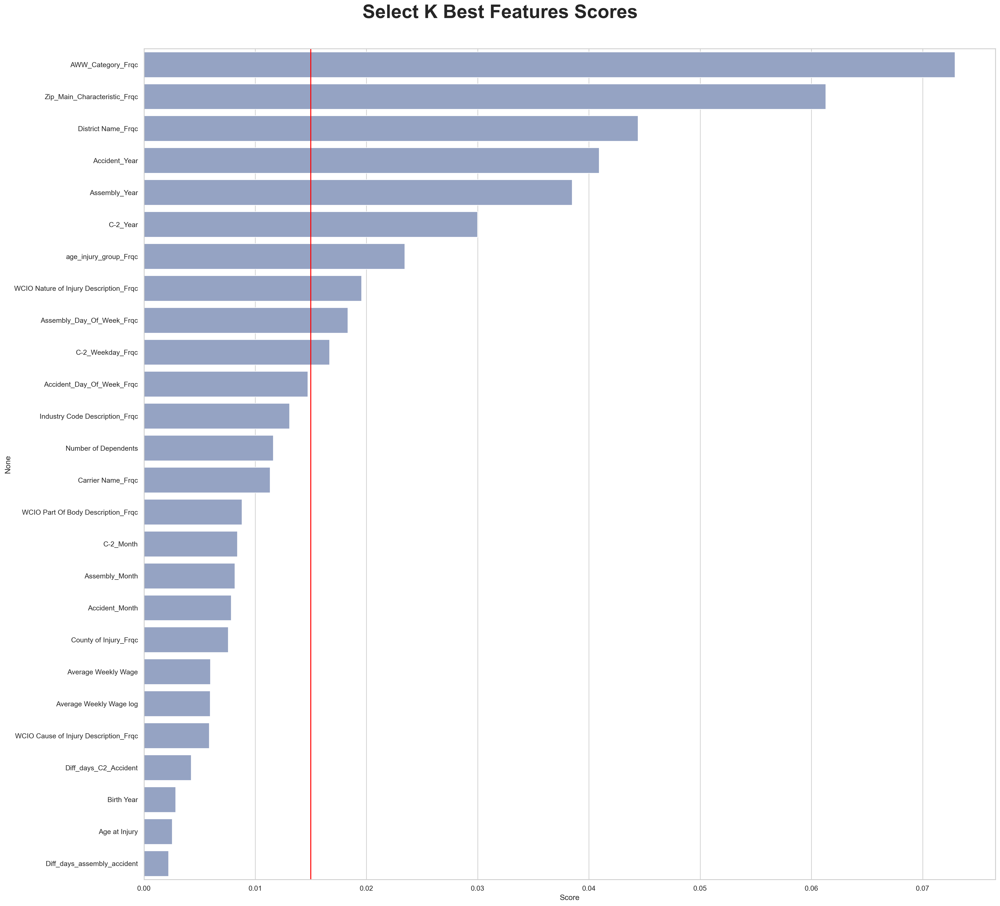

In [180]:
X_new2 = SelectKBest(score_func=mutual_info_classif,k='all').fit(X_train_num, target_train5)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=0.015, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Select K-Best: Categorical Variables**

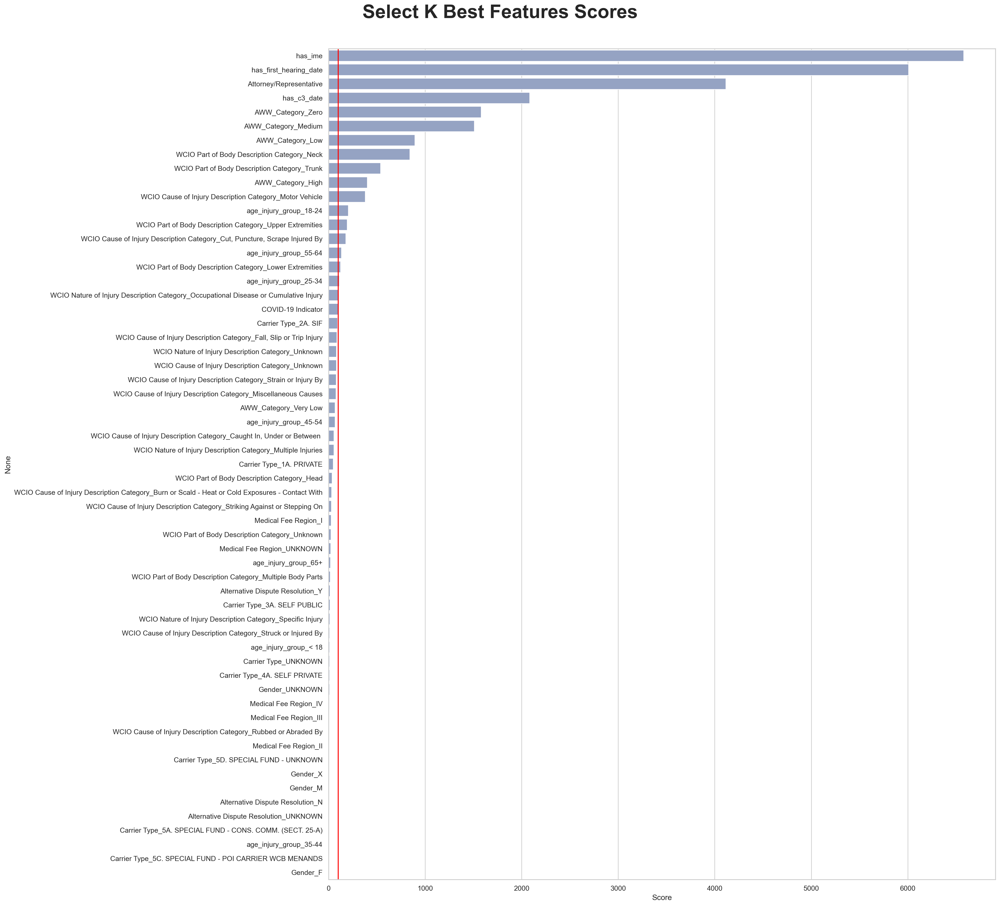

In [179]:
X_new2 = SelectKBest(score_func=chi2,k='all').fit(X_train_cat, target_train5)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=100, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Random Forest- Categorical Variables**

Threshould used: 0.017 (= 1 / 59 features)

In [92]:
rf = RandomForestClassifier()
rf.fit(X_train_cat, df_target_train5)
importances = rf.feature_importances_

In [93]:
feature_importance_df = pd.DataFrame({
    'Feature': X_train_cat.columns,
    'Importance': importances
})

feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

feature_importance_df

,Feature,Importance
1,has_c3_date,0.064635
55,age_injury_group_45-54,0.036598
4,has_ime,0.035871
8,Carrier Type_1A. PRIVATE,0.034605
54,age_injury_group_35-44,0.034295
39,WCIO Cause of Injury Description Category_Fall...,0.032133
3,has_first_hearing_date,0.032046
9,Carrier Type_2A. SIF,0.031726
56,age_injury_group_55-64,0.031529
10,Carrier Type_3A. SELF PUBLIC,0.031008


**Ridge Regression**

In [94]:
# Initialize the Logistic Regression model with L2 regularization and 'lbfgs' solver
model = LogisticRegression(penalty='l2', solver='lbfgs', max_iter=1000)

model.fit(X_train_num, target_train5)

coef = pd.Series(model.coef_[0], index=X_train_num.columns)


coef

Age at Injury                             1.029854
Average Weekly Wage                      -0.374472
Birth Year                               -2.132056
Number of Dependents                     -0.056881
Diff_days_assembly_accident              -0.106963
Average Weekly Wage log                   1.790710
Carrier Name_Frqc                         0.122150
County of Injury_Frqc                     0.244948
District Name_Frqc                        0.004099
Industry Code Description_Frqc            0.157702
WCIO Part Of Body Description_Frqc        0.279310
WCIO Nature of Injury Description_Frqc    0.559465
WCIO Cause of Injury Description_Frqc     0.289013
AWW_Category_Frqc                        -2.044616
age_injury_group_Frqc                     0.386103
Zip_Main_Characteristic_Frqc             -0.173530
Accident_Day_Of_Week_Frqc                 0.129017
Assembly_Day_Of_Week_Frqc                -0.897994
Accident_Year                            -1.307097
Accident_Month                 

#### Overall features importance for class 5

***Best Categorical:*** 'AWW_Category_Zero', 'has_ime', 'has_c3_date'<br>
***Best Numerical:*** 'Average Weekly Wage log', 'Birth Year'<br>

***Worst Categorical:*** 'age_injury_group_< 18', 'Alternative Dispute Resolution_UNKNOWN',  'Gender_F', Carrier Type 5A <br>
***Worst Numerical:*** 'age_injury_group_Frqc', 'Number of Dependents' <br>

### Class 6

**Spearman correlation matrix**

<Axes: >

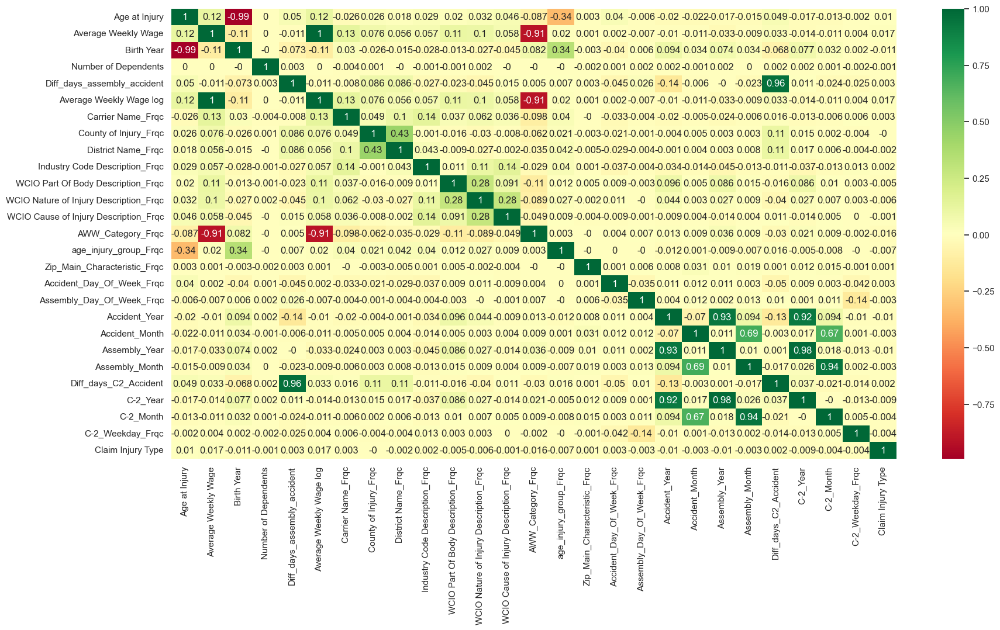

In [95]:
plt.figure(figsize=(20,10))
X_train_and_target= pd.concat([X_train_num, df_target_train6], axis=1)
sns.heatmap(X_train_and_target.corr(method='spearman').round(3), annot=True, cmap="RdYlGn")

**Cramer's V**

In [96]:
#Heatmap of Cramér's V
df_cramers = pd.concat([X_train_cat, df_target_train6], axis=1)
results = pd.DataFrame(index=df_cramers.columns, columns=df_cramers.columns)

for var1 in df_cramers.columns:
    for var2 in df_cramers.columns:
        if var1 != var2:
            results.loc[var1, var2] = cramers_v(df_cramers[var1], df_cramers[var2])
        else:
            results.loc[var1, var2] = 1

results = results.astype(float)
last_row_index = results.index[-1]
last_row = results.iloc[-1, :] 
lower_triangle_last_row = last_row.loc[:last_row_index]
pd.DataFrame(lower_triangle_last_row.sort_values(ascending=False)).T

,Claim Injury Type,has_ime,has_first_hearing_date,Attorney/Representative,AWW_Category_Zero,has_c3_date,AWW_Category_Medium,WCIO Nature of Injury Description Category_Occupational Disease or Cumulative Injury,age_injury_group_65+,AWW_Category_High,WCIO Nature of Injury Description Category_Specific Injury,AWW_Category_Low,WCIO Part of Body Description Category_Upper Extremities,COVID-19 Indicator,Carrier Type_5D. SPECIAL FUND - UNKNOWN,age_injury_group_25-34,WCIO Part of Body Description Category_Trunk,WCIO Part of Body Description Category_Head,age_injury_group_55-64,Carrier Type_2A. SIF,WCIO Cause of Injury Description Category_Miscellaneous Causes,"WCIO Cause of Injury Description Category_Cut, Puncture, Scrape Injured By",Gender_M,Medical Fee Region_UNKNOWN,Gender_F,WCIO Part of Body Description Category_Neck,WCIO Part of Body Description Category_Lower Extremities,WCIO Cause of Injury Description Category_Strain or Injury By,WCIO Nature of Injury Description Category_Multiple Injuries,Carrier Type_3A. SELF PUBLIC,age_injury_group_18-24,Medical Fee Region_IV,Medical Fee Region_II,Carrier Type_4A. SELF PRIVATE,"WCIO Cause of Injury Description Category_Fall, Slip or Trip Injury",age_injury_group_35-44,AWW_Category_Very Low,Carrier Type_1A. PRIVATE,"WCIO Cause of Injury Description Category_Caught In, Under or Between",WCIO Cause of Injury Description Category_Motor Vehicle,WCIO Part of Body Description Category_Unknown,Medical Fee Region_III,WCIO Nature of Injury Description Category_Unknown,WCIO Cause of Injury Description Category_Unknown,age_injury_group_45-54,Medical Fee Region_I,Gender_UNKNOWN,WCIO Cause of Injury Description Category_Burn or Scald - Heat or Cold Exposures - Contact With,WCIO Part of Body Description Category_Multiple Body Parts,Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A),Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS,WCIO Cause of Injury Description Category_Struck or Injured By,Carrier Type_UNKNOWN,WCIO Cause of Injury Description Category_Rubbed or Abraded By,Gender_X,Alternative Dispute Resolution_N,Alternative Dispute Resolution_Y,Alternative Dispute Resolution_UNKNOWN,age_injury_group_< 18,WCIO Cause of Injury Description Category_Striking Against or Stepping On
Claim Injury Type,1.0,0.021688,0.021607,0.018937,0.015762,0.013236,0.008591,0.00811,0.007989,0.007837,0.007293,0.006928,0.006871,0.0065,0.006224,0.00598,0.00579,0.005601,0.005189,0.004543,0.00447,0.003207,0.003022,0.002882,0.002811,0.002782,0.002714,0.00266,0.002493,0.002323,0.002063,0.00193,0.00185,0.001821,0.001556,0.001501,0.001486,0.000889,0.000829,0.000626,0.000586,0.000573,0.000418,0.000416,0.000327,0.000254,0.000127,0.000073,0.000025,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


**Select K-Best: Numerical Variables**

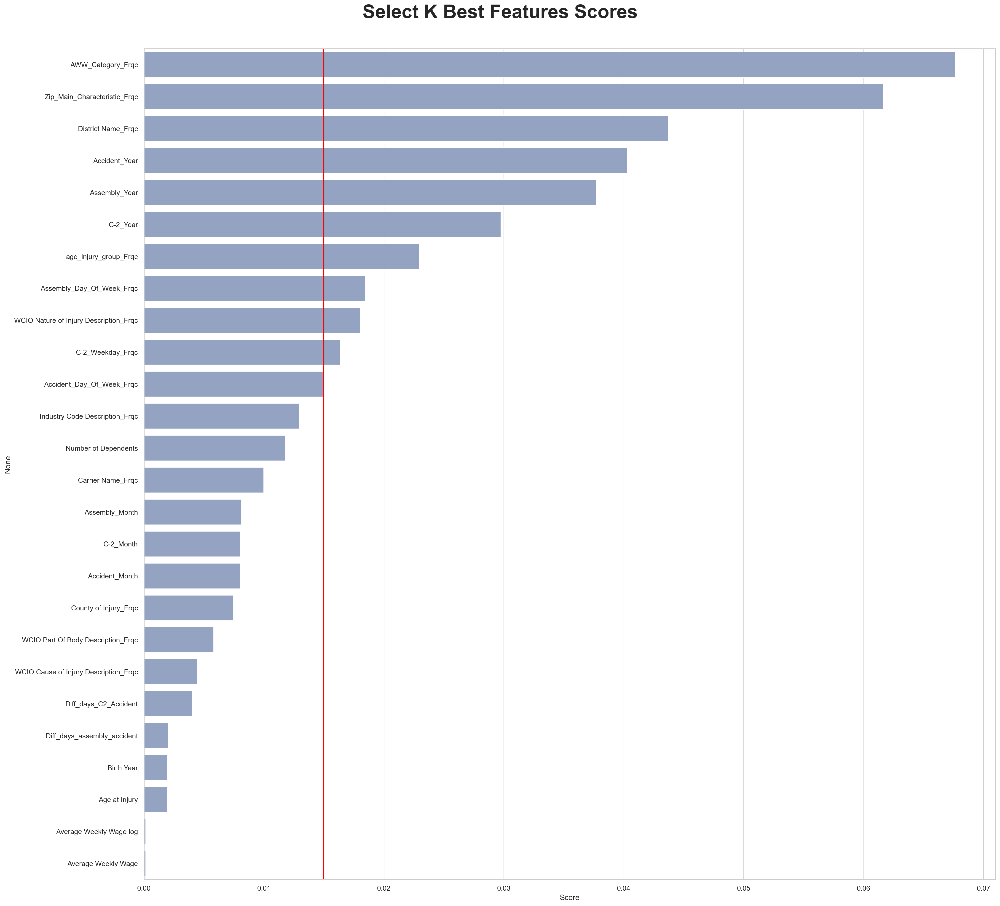

In [181]:
X_new2 = SelectKBest(score_func=mutual_info_classif,k='all').fit(X_train_num, target_train6)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=0.015, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Select K-Best: Categorical Variables**

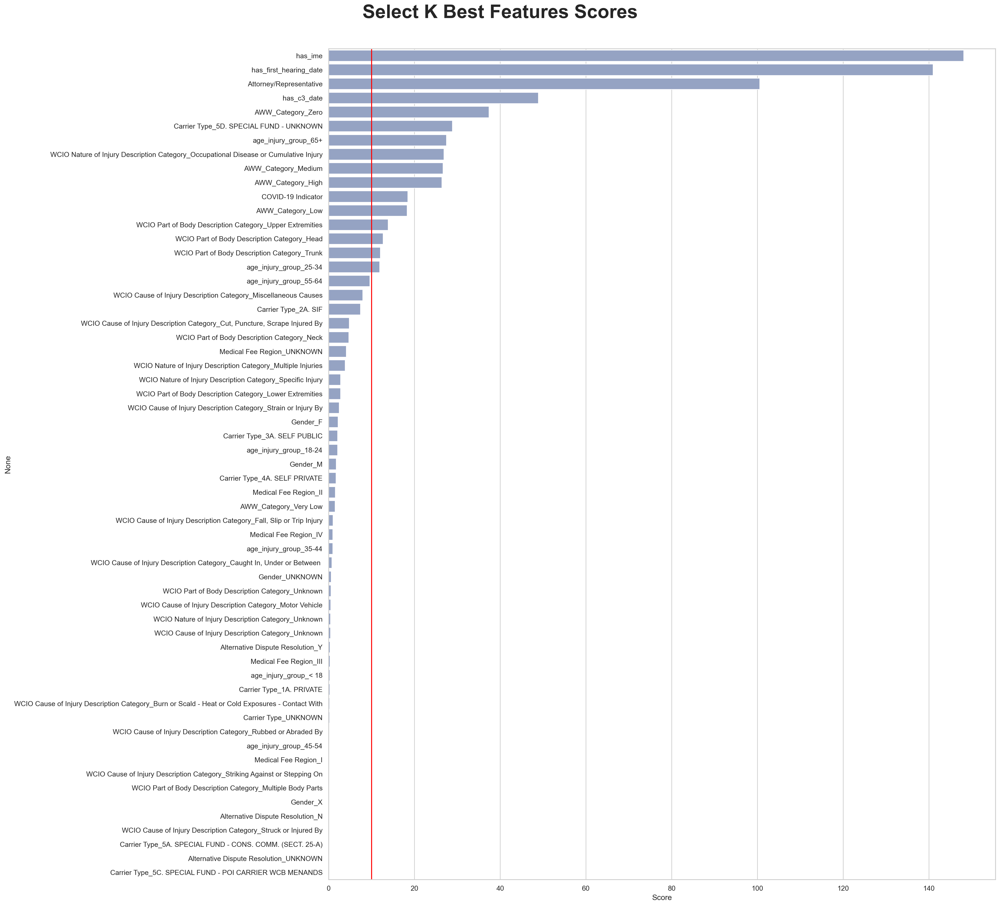

In [182]:
X_new2 = SelectKBest(score_func=chi2,k='all').fit(X_train_cat, target_train6)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=10, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Random Forest- Categorical Variables**

Threshould used: 0.017 (= 1 / 59 features)

In [99]:
rf = RandomForestClassifier()
rf.fit(X_train_cat, df_target_train6)
importances = rf.feature_importances_

In [100]:
feature_importance_df = pd.DataFrame({
    'Feature': X_train_cat.columns,
    'Importance': importances
})

feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

feature_importance_df

,Feature,Importance
1,has_c3_date,5.689332e-02
4,has_ime,4.851340e-02
20,Medical Fee Region_I,3.698929e-02
48,AWW_Category_Low,3.494115e-02
16,Gender_F,3.472170e-02
49,AWW_Category_Medium,3.449079e-02
9,Carrier Type_2A. SIF,3.394938e-02
56,age_injury_group_55-64,3.160392e-02
8,Carrier Type_1A. PRIVATE,3.091661e-02
39,WCIO Cause of Injury Description Category_Fall...,3.076466e-02


**Ridge Regression**

In [101]:
# Initialize the Logistic Regression model with L2 regularization and 'lbfgs' solver
model = LogisticRegression(penalty='l2', solver='lbfgs', max_iter=1000)

model.fit(X_train_num, target_train6)

coef = pd.Series(model.coef_[0], index=X_train_num.columns)
coef

Age at Injury                            -0.362402
Average Weekly Wage                      -0.025322
Birth Year                               -0.585711
Number of Dependents                     -0.392177
Diff_days_assembly_accident              -0.046151
Average Weekly Wage log                  -0.125734
Carrier Name_Frqc                        -0.131026
County of Injury_Frqc                    -0.385990
District Name_Frqc                       -0.431178
Industry Code Description_Frqc           -0.386952
WCIO Part Of Body Description_Frqc       -0.409108
WCIO Nature of Injury Description_Frqc   -0.410659
WCIO Cause of Injury Description_Frqc    -0.341336
AWW_Category_Frqc                        -0.697567
age_injury_group_Frqc                    -0.702540
Zip_Main_Characteristic_Frqc             -0.726303
Accident_Day_Of_Week_Frqc                -0.594321
Assembly_Day_Of_Week_Frqc                -0.813670
Accident_Year                            -0.813532
Accident_Month                 

#### Overall features importance for class 6

***Best Categorical:*** 'AWW_Category_Zero', 'has_ime'<br>
***Best Numerical:*** 'Average Weekly Wage log', 'Birth Year'<br>

***Worst Categorical:*** 'Alternative Dispute Resolution_UNKNOWN', Carrier Type: 5A, 5C, 5D, 'WCIO Cause of Injury Description Category_Striking Against or Stepping On' <br>
***Worst Numerical:*** 'WCIO Cause of Injury Description_Frqc' <br>

### Class 7

**Spearman correlation matrix**

<Axes: >

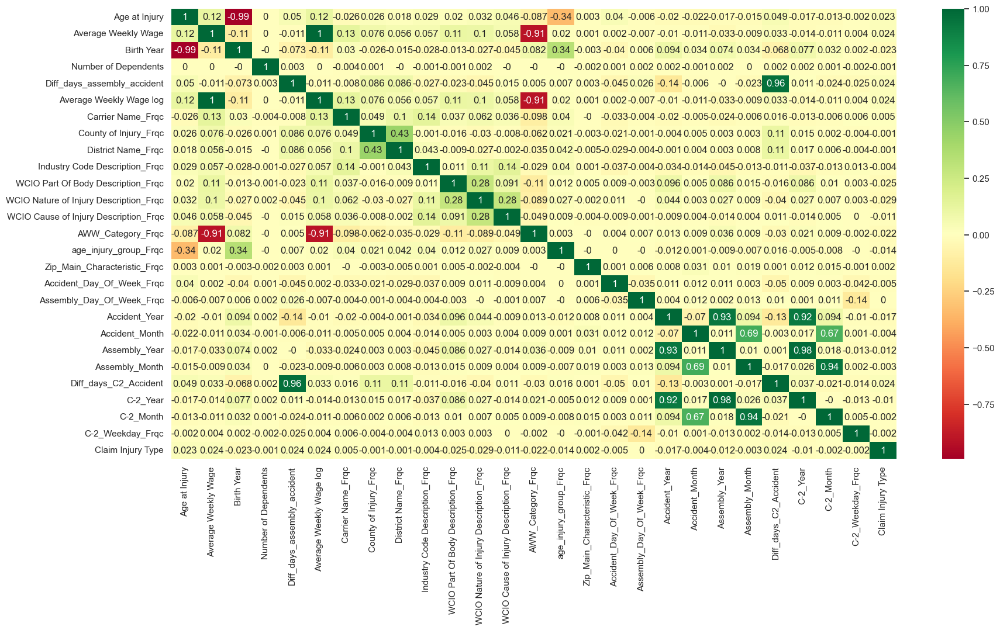

In [102]:
plt.figure(figsize=(20,10))
X_train_and_target= pd.concat([X_train_num, df_target_train7], axis=1)
sns.heatmap(X_train_and_target.corr(method='spearman').round(3), annot=True, cmap="RdYlGn")

**Cramer's V**

In [103]:
#Heatmap of Cramér's V
df_cramers = pd.concat([X_train_cat, df_target_train7], axis=1)
results = pd.DataFrame(index=df_cramers.columns, columns=df_cramers.columns)

for var1 in df_cramers.columns:
    for var2 in df_cramers.columns:
        if var1 != var2:
            results.loc[var1, var2] = cramers_v(df_cramers[var1], df_cramers[var2])
        else:
            results.loc[var1, var2] = 1

results = results.astype(float)
last_row_index = results.index[-1]
last_row = results.iloc[-1, :] 
lower_triangle_last_row = last_row.loc[:last_row_index]
pd.DataFrame(lower_triangle_last_row.sort_values(ascending=False)).T

,Claim Injury Type,has_first_hearing_date,WCIO Nature of Injury Description Category_Occupational Disease or Cumulative Injury,COVID-19 Indicator,WCIO Nature of Injury Description Category_Specific Injury,WCIO Cause of Injury Description Category_Miscellaneous Causes,Attorney/Representative,age_injury_group_65+,AWW_Category_Zero,WCIO Part of Body Description Category_Trunk,WCIO Part of Body Description Category_Upper Extremities,Gender_M,WCIO Nature of Injury Description Category_Multiple Injuries,Gender_F,WCIO Part of Body Description Category_Multiple Body Parts,Medical Fee Region_UNKNOWN,AWW_Category_Medium,WCIO Cause of Injury Description Category_Strain or Injury By,has_c3_date,WCIO Part of Body Description Category_Lower Extremities,AWW_Category_Low,Carrier Type_5D. SPECIAL FUND - UNKNOWN,Carrier Type_2A. SIF,age_injury_group_25-34,WCIO Cause of Injury Description Category_Motor Vehicle,age_injury_group_55-64,age_injury_group_18-24,AWW_Category_High,"WCIO Cause of Injury Description Category_Cut, Puncture, Scrape Injured By",Carrier Type_1A. PRIVATE,"WCIO Cause of Injury Description Category_Fall, Slip or Trip Injury",WCIO Cause of Injury Description Category_Struck or Injured By,age_injury_group_35-44,Medical Fee Region_II,WCIO Cause of Injury Description Category_Striking Against or Stepping On,Carrier Type_4A. SELF PRIVATE,Medical Fee Region_IV,WCIO Nature of Injury Description Category_Unknown,WCIO Cause of Injury Description Category_Unknown,Gender_UNKNOWN,WCIO Part of Body Description Category_Unknown,AWW_Category_Very Low,Medical Fee Region_III,"WCIO Cause of Injury Description Category_Caught In, Under or Between",WCIO Cause of Injury Description Category_Burn or Scald - Heat or Cold Exposures - Contact With,Alternative Dispute Resolution_N,Alternative Dispute Resolution_Y,Carrier Type_UNKNOWN,WCIO Part of Body Description Category_Neck,has_ime,Carrier Type_3A. SELF PUBLIC,age_injury_group_45-54,WCIO Cause of Injury Description Category_Rubbed or Abraded By,WCIO Part of Body Description Category_Head,Medical Fee Region_I,Gender_X,Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS,Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A),age_injury_group_< 18,Alternative Dispute Resolution_UNKNOWN
Claim Injury Type,1.0,0.047627,0.041305,0.041022,0.038764,0.036432,0.035552,0.028417,0.023596,0.021902,0.018437,0.016648,0.016455,0.016218,0.015193,0.015141,0.015095,0.014513,0.014251,0.013492,0.011585,0.01016,0.009928,0.009633,0.009146,0.008258,0.008103,0.007617,0.006975,0.006335,0.006328,0.006308,0.00572,0.00558,0.005086,0.004355,0.004248,0.002349,0.002346,0.00211,0.001986,0.001951,0.001817,0.001756,0.001574,0.001272,0.001269,0.000794,0.000792,0.000351,0.000293,0.000258,0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0


**Select K-Best: Numerical Variables**

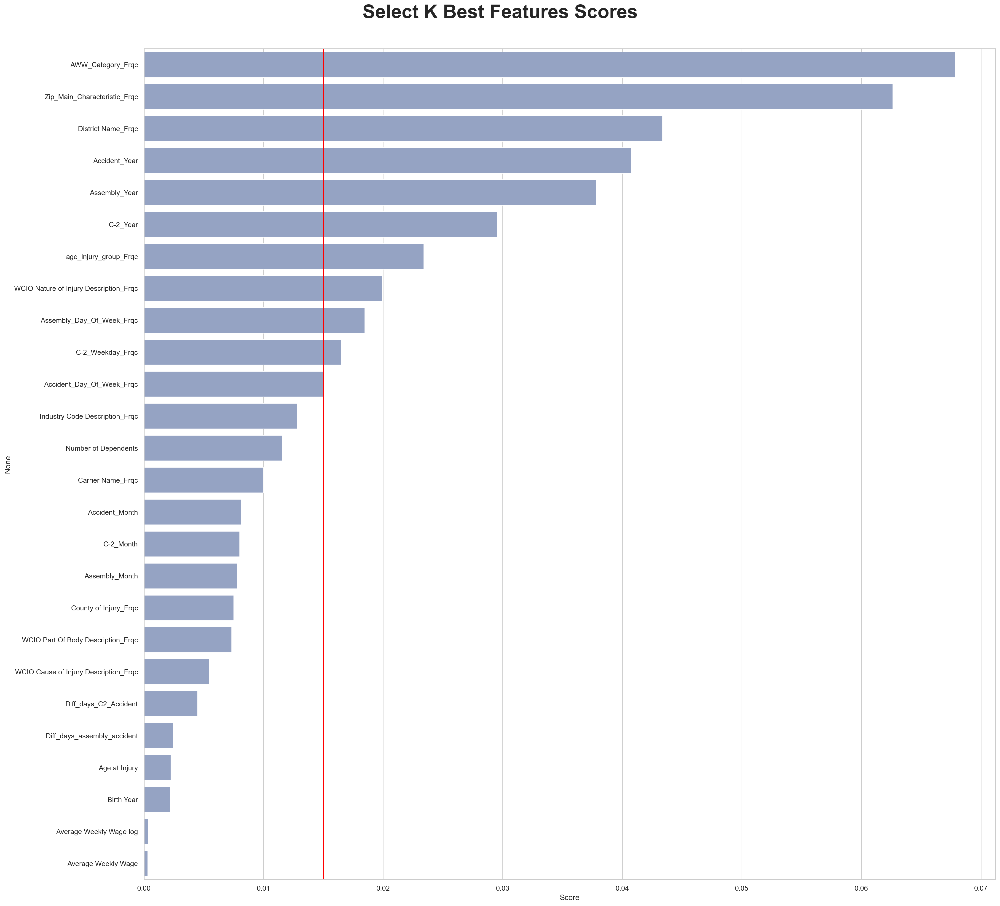

In [183]:
X_new2 = SelectKBest(score_func=mutual_info_classif,k='all').fit(X_train_num, target_train7)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=0.015, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Select K-Best: Categorical Variables**

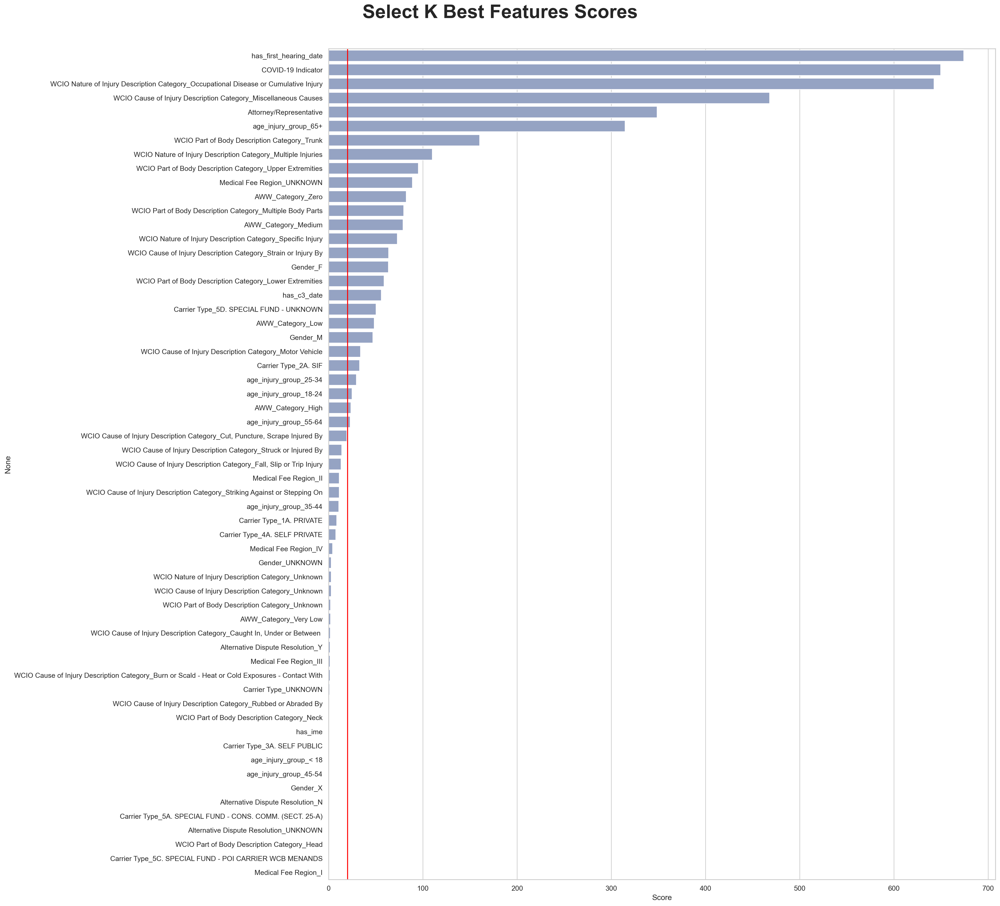

In [184]:
X_new2 = SelectKBest(score_func=chi2,k='all').fit(X_train_cat, target_train7)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=20, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Random Forest- Categorical Variables**

Threshould used: 0.017 (= 1 / 59 features)

In [106]:
rf = RandomForestClassifier()
rf.fit(X_train_cat, df_target_train7)
importances = rf.feature_importances_

In [107]:
feature_importance_df = pd.DataFrame({
    'Feature': X_train_cat.columns,
    'Importance': importances
})

feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

feature_importance_df

,Feature,Importance
1,has_c3_date,1.156738e-01
4,has_ime,5.626638e-02
0,Attorney/Representative,4.949869e-02
3,has_first_hearing_date,3.480861e-02
23,Medical Fee Region_IV,3.295130e-02
49,AWW_Category_Medium,3.226047e-02
51,AWW_Category_Zero,3.215074e-02
8,Carrier Type_1A. PRIVATE,2.983447e-02
9,Carrier Type_2A. SIF,2.953021e-02
48,AWW_Category_Low,2.805253e-02


**Ridge Regression**

In [108]:
# Initialize the Logistic Regression model with L2 regularization and 'lbfgs' solver
model = LogisticRegression(penalty='l2', solver='lbfgs', max_iter=1000)

model.fit(X_train_num, target_train7)

coef = pd.Series(model.coef_[0], index=X_train_num.columns)


coef

Age at Injury                             0.864127
Average Weekly Wage                       0.327240
Birth Year                               -1.237148
Number of Dependents                     -0.113938
Diff_days_assembly_accident              -0.009447
Average Weekly Wage log                   0.936682
Carrier Name_Frqc                         0.827003
County of Injury_Frqc                    -0.205577
District Name_Frqc                       -0.040464
Industry Code Description_Frqc           -0.341831
WCIO Part Of Body Description_Frqc       -2.041099
WCIO Nature of Injury Description_Frqc   -2.507915
WCIO Cause of Injury Description_Frqc    -0.722697
AWW_Category_Frqc                        -1.387602
age_injury_group_Frqc                    -1.266713
Zip_Main_Characteristic_Frqc             -0.057845
Accident_Day_Of_Week_Frqc                -0.634207
Assembly_Day_Of_Week_Frqc                -0.451602
Accident_Year                            -0.598175
Accident_Month                 

#### Overall features importance for class 7

***Best Categorical:*** 'AWW_Category_Zero', 'has_first_hearing_date', 'has_c3_date'<br>
***Best Numerical:*** 'Birth Year', 'WCIO Nature of Injury Description_Frqc'<br>

***Worst Categorical:*** 'Medical Fee Region_I', 'Alternative Dispute Resolution_UNKNOWN', Carrier Type 5C <br>
***Worst Numerical:*** 'District Name_Frqc', 'Number of Dependents' <br>

<a class="anchor" id="2.5">

## Final Insights
    
</a>

Selection of which features to mantain and which to drop. <br> Based on the  methods used, we present a summary table below with the features we will include, discard and try with or without in the model.

Results for the Numerical Features

In [ ]:
feature_selection_df = pd.DataFrame({'Feature': X_train_num.columns})

#RFE results
feature_selection_df['RFE'] = selected_features.values

#Random Forest results
feature_selection_df['Random Forest'] = embeded_rf_selector.get_support()

#Ridge results
ridge_importance = (coef != 0).values
feature_selection_df['Ridge (L2)'] = ridge_importance


#Spearman 
feature_selection_df['Spearman'] = feature_selection_df['Feature'].isin(spearman_selected)

#Select K-Best
feature_selection_df['K-Best'] = k_features_num.values

#Decision Tree results (both Gini and Entropy)
gini_importance = DecisionTreeClassifier().fit(X_train_num, target_train).feature_importances_
entropy_importance = DecisionTreeClassifier(criterion='entropy').fit(X_train_num, target_train).feature_importances_

feature_selection_df['Decision Tree (Gini)'] = gini_importance > 0
feature_selection_df['Decision Tree (Entropy)'] = entropy_importance > 0

#Calculate the total times a feature is selected
feature_selection_df['Total'] = feature_selection_df.iloc[:, 1:].sum(axis=1)

#Sort and reset index
feature_selection_df = feature_selection_df.sort_values(['Total', 'Feature'], ascending=False)
feature_selection_df.index = range(1, len(feature_selection_df) + 1)

feature_selection_df.head(len(X_train_num.columns))


,Feature,RFE,Random Forest,Ridge (L2),Spearman,K-Best,Decision Tree (Gini),Decision Tree (Entropy),Total
1,WCIO Nature of Injury Description_Frqc,True,True,True,True,True,True,True,7
2,Carrier Name_Frqc,True,True,True,True,True,True,True,7
3,Birth Year,True,True,True,True,True,True,True,7
4,Age at Injury,True,True,True,True,True,True,True,7
5,WCIO Part Of Body Description_Frqc,False,True,True,True,True,True,True,6
6,Industry Code Description_Frqc,True,True,True,False,True,True,True,6
7,County of Injury_Frqc,True,True,True,False,True,True,True,6
8,Average Weekly Wage log,True,False,True,True,True,True,True,6
9,Average Weekly Wage,True,False,True,True,True,True,True,6
10,AWW_Category_Frqc,True,False,True,True,True,True,True,6


Results for the categorical features

In [ ]:
feature_selection_df = pd.DataFrame({'Feature': X_train_cat.columns})

#Random Forest results
feature_selection_df['Random Forest (Categorical)'] = feature_selection_df['Feature'].isin(rf_selected_cat)

# Filter based on threshold > 0.001
feature_importance = pd.to_numeric(feature_importance_df['Importance'], errors='coerce')
feature_selection_df['Mutual Information'] = feature_importance > 0.001

#Mutual Information
feature_selection_df['Mutual Information'] = feature_importance >0.001

#Chi-Squared
chi2_results_series = pd.Series(chi2_results, index=X_train_cat.columns)
feature_selection_df['Chi-Squared'] = feature_selection_df['Feature'].map(chi2_results_series).fillna(False).astype(bool)

#Cramer's V
feature_selection_df['Cramer\'s V'] = feature_selection_df['Feature'].isin(cramers_v_selected)

#Select K-Best
feature_selection_df['K-Best'] = k_features_cat.values

#Calculate the total times a feature is selected
feature_selection_df['Total'] = feature_selection_df.iloc[:, 1:].sum(axis=1)

#Sort and reset index
feature_selection_df = feature_selection_df.sort_values(['Total', 'Feature'], ascending=False)
feature_selection_df.index = range(1, len(feature_selection_df) + 1)

feature_selection_df.head(len(X_train_cat.columns))


,Feature,Random Forest (Categorical),Mutual Information,Chi-Squared,Cramer's V,K-Best,Total
1,has_ime,True,True,True,True,True,5
2,has_first_hearing_date,True,True,True,True,True,5
3,has_c3_date,True,True,True,True,True,5
4,WCIO Part of Body Description Category_Unknown,True,True,True,True,True,5
5,WCIO Nature of Injury Description Category_Unk...,True,True,True,True,True,5
6,WCIO Nature of Injury Description Category_Spe...,True,True,True,True,True,5
7,WCIO Cause of Injury Description Category_Unknown,True,True,True,True,True,5
8,Attorney/Representative,True,True,True,True,True,5
9,AWW_Category_Zero,True,True,True,True,True,5
10,AWW_Category_Very Low,True,True,True,True,True,5


In [ ]:
final_features_for_model = [ "Age at Injury",
    "Diff_days_assembly_accident",
    "Diff_days_C2_Accident",
    "WCIO Nature of Injury Description_Frqc",
    "WCIO Part Of Body Description_Frqc",
    "Average Weekly Wage log",
    "Carrier Name_Frqc",
    "County of Injury_Frqc",
    "Industry Code Description_Frqc",
    "District Name_Frqc",
    "AWW_Category_Frqc",
    'Attorney/Representative', 
    'has_c3_date', 'COVID-19 Indicator', 
    'has_first_hearing_date', 'has_ime',
    'Alternative Dispute Resolution_N', 
    'Alternative Dispute Resolution_Y', 'Carrier Type_1A. PRIVATE',
    'Carrier Type_2A. SIF', 'Carrier Type_3A. SELF PUBLIC', 
    'Carrier Type_4A. SELF PRIVATE',
    'Medical Fee Region_I', 'Medical Fee Region_II', 
    'Medical Fee Region_III', 'Medical Fee Region_IV',
    'WCIO Part of Body Description Category_Head',
    'WCIO Part of Body Description Category_Lower Extremities', 
    'WCIO Part of Body Description Category_Multiple Body Parts',
    'WCIO Part of Body Description Category_Neck', 
    'WCIO Part of Body Description Category_Trunk',
    'WCIO Part of Body Description Category_Upper Extremities',
    'WCIO Nature of Injury Description Category_Multiple Injuries', 
    'WCIO Nature of Injury Description Category_Occupational Disease or Cumulative Injury',
    'WCIO Nature of Injury Description Category_Specific Injury', 
    'WCIO Cause of Injury Description Category_Burn or Scald - Heat or Cold Exposures - Contact With',
    'WCIO Cause of Injury Description Category_Cut, Puncture, Scrape Injured By',
    'WCIO Cause of Injury Description Category_Fall, Slip or Trip Injury', 
    'WCIO Cause of Injury Description Category_Miscellaneous Causes',
    'WCIO Cause of Injury Description Category_Motor Vehicle', 
    'WCIO Cause of Injury Description Category_Strain or Injury By',
    'WCIO Cause of Injury Description Category_Striking Against or Stepping On', 
    'WCIO Cause of Injury Description Category_Struck or Injured By', 
    'AWW_Category_High', 'AWW_Category_Low', 'AWW_Category_Medium',
    'AWW_Category_Very Low', 'AWW_Category_Zero', 'age_injury_group_18-24', 
    'age_injury_group_25-34', 'age_injury_group_35-44',
    'age_injury_group_45-54', 'age_injury_group_55-64', 'age_injury_group_65+',
    'Gender_F', 'Gender_M']